# Introduction

### Background

Object detection is a crucial task in computer vision, aiming to identify and locate objects of interest within images or videos. It has broad applications in various fields, including autonomous driving, robotics, surveillance, and medical imaging. In recent years, deep learning-based object detection models have achieved significant progress, surpassing traditional methods in accuracy and efficiency.

Traffic sign detection is a specific application of object detection that plays a vital role in intelligent transportation systems and autonomous driving technologies. Accurate and timely detection of traffic signs is essential for ensuring road safety, enabling autonomous navigation, and enhancing the overall efficiency of transportation networks. Recognizing traffic signs accurately and quickly can help drivers avoid accidents and make informed decisions on the road.

### YOLO (You Only Look Once)

Among the state-of-the-art object detection models, YOLO (You Only Look Once) stands out for its efficiency and accuracy. YOLO's architecture allows it to process images effectively, making it suitable for various applications, including traffic sign detection. It has been continuously improved through various versions, enhancing its performance and expanding its capabilities for diverse object detection tasks.

### Project Goals

This project delves into the practical application of deep learning for traffic sign detection, utilizing the powerful YOLO (You Only Look Once) framework. The central objectives are to:

1. Gain hands-on experience in implementing and fine-tuning state-of-the-art object detection models. This involves understanding the intricacies of YOLO, configuring its training parameters, and optimizing its performance for the specific task of traffic sign detection.
2. Develop a functional traffic sign detection system capable of identifying and localizing traffic signs in images with reasonable accuracy. This entails achieving a model that can effectively generalize to new, unseen images and perform well under various real-world conditions.
3. Explore and evaluate the effectiveness of different strategies for data preparation, model training, and performance optimization. This involves experimenting with various data augmentation techniques, hyperparameter tuning approaches, and evaluation metrics to gain valuable insights into the process of building robust deep learning systems.
4. Build a solid foundation for further exploration and development in the field of computer vision and deep learning. This project serves as a stepping stone for future endeavors, allowing me to expand my knowledge and skills in these rapidly evolving domains.

# Data Collection

This project utilizes the Open Images V7 dataset, a large and publicly available dataset released by Google.

Using an open-source tool, the Traffic Sign dataset for detection tasks was downloaded. This dataset comprises 2817 images, with all objects belonging to a single class.



After collecting the traffic sign images and annotations from the Open Images V7 dataset, the data was uploaded to Google Drive for convenient access within the Colab environment. The following three code cells handle the initial setup: mounting Google Drive to Colab, extracting the dataset to the main Colab directory, and defining paths to the image and label directories

This ensures our data is organized and easily accessible for subsequent analysis and model training within this Colab notebook.

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
!unzip -q "/content/drive/My Drive/traffic_signs.zip" -d "/content"

In [ ]:
import os

# Define the paths to the image and label directories
images_dir = "/content/images"
labels_dir = "/content/labels"

#Data Validation

After collecting the data, it's crucial to validate its quality and integrity before proceeding with further analysis and model training. Data validation helps ensure that the dataset is reliable and suitable for the intended task.

1. **Check for Missing Files**: Verify that each image file in the dataset has a corresponding label file containing its bounding box annotations. Any mismatches or missing files should be addressed

In [ ]:
# List all files in the directories
image_files = set(f.split('.')[0] for f in os.listdir(images_dir) if f.endswith('.jpg'))
label_files = set(f.split('.')[0] for f in os.listdir(labels_dir) if f.endswith('.txt'))

# Check for missing files
missing_labels = image_files - label_files
missing_images = label_files - image_files

print(f"Missing labels: {missing_labels}")
print(f"Missing images: {missing_images}")


Missing labels: set()
Missing images: set()


2. **Check for Corrupt Images**: Examine the image files to identify any corrupt or unreadable images. Corrupted images can hinder the model training process and should be removed from the dataset.

In [ ]:
from PIL import Image

def check_corrupt_images(images_dir):
    corrupt_images = []
    for filename in os.listdir(images_dir):
        if filename.endswith(".jpg"):  # Adjust file extension if needed
            try:
                with Image.open(os.path.join(images_dir, filename)) as img:
                    img.verify()  # Verify image integrity
            except (IOError, SyntaxError) as e:
                corrupt_images.append(filename)
                print(f"Corrupt image: {filename}, Error: {e}")
    return corrupt_images

corrupt_images = check_corrupt_images(images_dir)

3. **Check for Empty Images**: Ensure there are no empty image files (i.e., images with zero size or no content). Empty images should be removed as they don't contribute to model training.

In [ ]:
import os
import cv2

def check_empty_images(images_dir):
    empty_images = []
    for filename in os.listdir(images_dir):
        if filename.endswith(".jpg"):  # Adjust file extension if needed
            image_path = os.path.join(images_dir, filename)
            image = cv2.imread(image_path)
            if image is None or image.size == 0:
                empty_images.append(filename)
                print(f"Empty image: {filename}")
    return empty_images

empty_images = check_empty_images(images_dir)

##Results
The data validation process revealed that there were no missing labels or images in the dataset. Additionally, no corrupt or empty images were detected. This indicates that the dataset is complete and contains valid image and label files, ensuring a reliable foundation for further analysis and model training.

# Exploratory Data Analysis (EDA)

Now we will perform exploratory data analysis (EDA) to understand the characteristics of the dataset. This includes **analyzing the class distribution, visualizing bounding boxes, and examining object sizes**. This analysis helps us identify potential issues or biases in the data and guide our data preparation strategy.

##General Stats

First, let's determine the number of images and objects in the dataset.

In [ ]:
import os

def count_images_and_objects(images_dir, labels_dir):

    num_images = len([f for f in os.listdir(images_dir) if f.endswith(".jpg")])
    num_objects = 0

    for filename in os.listdir(labels_dir):
        if filename.endswith(".txt"):
            label_path = os.path.join(labels_dir, filename)
            with open(label_path, "r") as f:
                num_objects += len(f.readlines())  # Count objects in each label file

    avg_objects_per_image = num_objects / num_images if num_images else 0  # Avoid division by zero

    return num_images, num_objects, avg_objects_per_image

# use:
num_images, num_objects, avg_objects_per_image = count_images_and_objects(images_dir, labels_dir)

print(f"Number of images: {num_images}")
print(f"Number of objects: {num_objects}")
print(f"Average objects per image: {avg_objects_per_image:.2f}")

Number of images: 2817
Number of objects: 6112
Average objects per image: 2.17


##Label Format

In [ ]:
# Examine a few label files
for i, filename in enumerate(os.listdir(labels_dir)[:5]):  # Examine the first 5 files
    if filename.endswith(".txt"):
        label_path = os.path.join(labels_dir, filename)
        print(f"--- Contents of {filename} ---")
        with open(label_path, "r") as f:
            for line in f:
                print(line.strip())  # Print each line without extra whitespace
        print("\n")  # Add an empty line between files

--- Contents of 5cbad851dd00e7df.txt ---
Traffic sign 0.0 328.775085 44.8 348.60389399999997
Traffic sign 42.24 293.59430100000003 99.84 307.666359
Traffic sign 337.28 465.018192 433.28 497.639781
Traffic sign 413.44 512.351478 554.24 557.126208


--- Contents of 0ee1826b87554d8b.txt ---
Traffic sign 95.255552 31.077756 526.553088 167.289948


--- Contents of d993b71f9033468e.txt ---
Traffic sign 19.2 61.490295999999994 327.68 211.372378
Traffic sign 275.84 493.202444 312.32 569.4245900000001
Traffic sign 583.04 602.091224 589.44 613.6208260000001
Traffic sign 683.52 3.842972 1000.96 197.92129000000003


--- Contents of 7c90a68215b60773.txt ---
Traffic sign 18.432 186.368256 149.504 303.10425599999996


--- Contents of d593e880e81fb517.txt ---
Traffic sign 203.873141 65.28 359.663141 224.0
Traffic sign 244.26314100000002 0.0 398.771047 136.96
Traffic sign 538.533141 353.92 576.358953 394.24
Traffic sign 538.533141 381.44 576.358953 426.88




Each line in the output represents a bounding box annotation for an object in the corresponding image:

class_name x_min y_min x_max y_max

* class_name: The name of the object class
* x_min, y_min: Upper-left corner coordinates of bbox
* x_max, y_max: Lower-right corner coordinates of bbox


##Class Distribution

In [ ]:
from collections import Counter

# Initialize a counter to store class frequencies
class_counts = Counter()

# Iterate through all label files
for filename in os.listdir(labels_dir):
    if filename.endswith(".txt"):
        label_path = os.path.join(labels_dir, filename)
        with open(label_path, "r") as f:
            for line in f:
                parts = line.split()
                class_name = parts[0] + " " + parts[1]  # Combine the first two elements
                class_counts[class_name] += 1  # Increment the count for this class

# Print the class distribution
print("Class Distribution:")
for class_name, count in class_counts.items():
    print(f"{class_name}: {count}")

Class Distribution:
Traffic sign: 6112


As expected when collected, we only have a single class. This class represents traffic signs, as is the focus of this project.




##Visualizing Bounding Boxes

Now, let's visualize a random sample of images with the bounding boxes.

By doing this, we can get a better understanding of the overall accuracy of the bounding boxes and identify any patterns in the inaccuracies

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt

def visualize_image_with_bbox(image_dir, labels_dir, image_filename):
  """Visualizes an image with its bounding boxes."""

  image_path = os.path.join(image_dir, image_filename)
  label_path = os.path.join(labels_dir, image_filename.replace(".jpg", ".txt"))

  # Load the image
  image = cv2.imread(image_path)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB

  # Read bounding box information from the label file
  with open(label_path, "r") as f:
    for line in f:
      parts = line.split()
      class_name = parts[0] + " " + parts[1]  # Combine the first two elements
      x_min, y_min, x_max, y_max = map(float, parts[2:])

      # Draw the bounding box
      x_min, y_min, x_max, y_max = int(x_min), int(y_min), int(x_max), int(y_max)
      cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)
      cv2.putText(image, class_name, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

  return image  # Return the image with bounding boxes

def visualize_samples(image_dir, labels_dir, num_samples=8, images_per_row=4):
  """Visualizes a random sample of images with their bounding boxes."""

  image_filenames = [f for f in os.listdir(image_dir) if f.endswith(".jpg")]
  random.shuffle(image_filenames)

  num_images = min(num_samples, len(image_filenames))
  num_rows = (num_images + images_per_row - 1) // images_per_row

  fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 10))  # Adjust figsize if needed
  fig.tight_layout()

  for i in range(num_images):
    image_filename = image_filenames[i]
    image_with_bbox = visualize_image_with_bbox(image_dir, labels_dir, image_filename)

    row = i // images_per_row
    col = i % images_per_row

    # Plot on the correct subplot
    if num_rows == 1:  # If only one row, axes is a 1D array
      axes[col].imshow(image_with_bbox)
      axes[col].set_title(image_filename)
      axes[col].axis("off")
    else:
      axes[row, col].imshow(image_with_bbox)
      axes[row, col].set_title(image_filename)
      axes[row, col].axis("off")

  # Hide empty subplots if any
  for i in range(num_images, num_rows * images_per_row):
    row = i // images_per_row
    col = i % images_per_row
    if num_rows == 1:  # If only one row, axes is a 1D array
      axes[col].axis("off")
    else:
      axes[row, col].axis("off")

  plt.tight_layout(pad=0.5)
  plt.show()



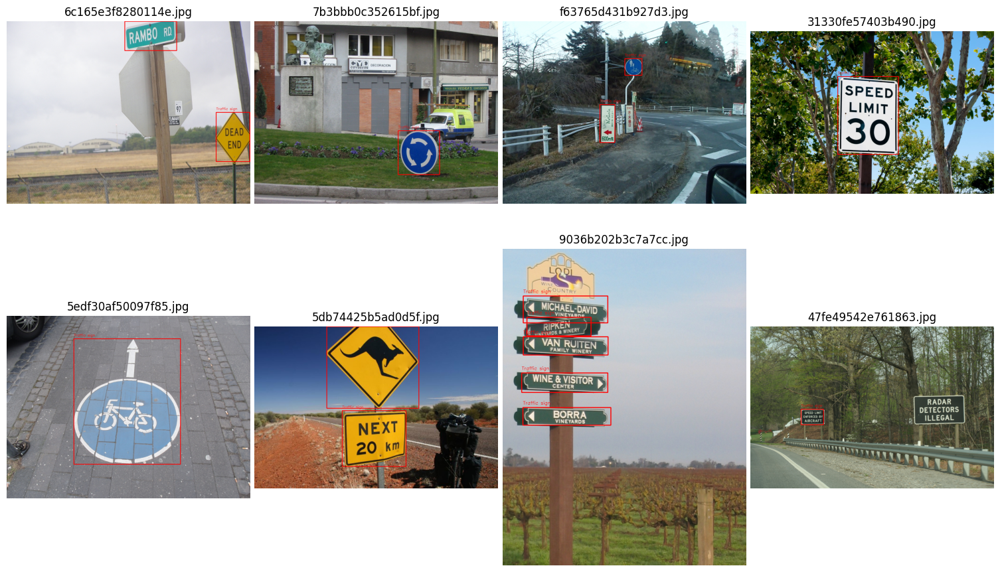

In [ ]:
# Example usage
visualize_samples(images_dir, labels_dir)

The bounding boxes generally align well with the objects in the images, indicating accurate annotation.

##Object Size Analysis

Let's analyze the object sizes and aspect ratios. This analysis can provide valuable insights into the scale variations and shape characteristics of the objects, informing data preparation and model training strategies.

Mean width: 202.6261274558246
Mean height: 174.58219687794505
Mean aspect ratio: 1.3400642269555623


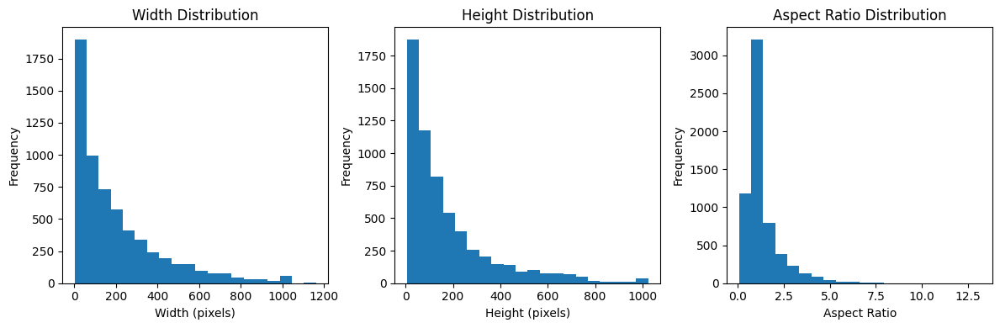

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

widths = []
heights = []
aspect_ratios = []

for filename in os.listdir(labels_dir):
    if filename.endswith(".txt"):
        label_path = os.path.join(labels_dir, filename)
        image_path = os.path.join(images_dir, filename.replace(".txt", ".jpg"))

        # Read bounding box information from the label file
        with open(label_path, "r") as f:
            for line in f:
                parts = line.split()
                x_min, y_min, x_max, y_max = map(float, parts[2:])

                # Calculate width and height
                width = x_max - x_min
                height = y_max - y_min

                widths.append(width)
                heights.append(height)
                aspect_ratios.append(width / height)

# Calculate statistics
mean_width = np.mean(widths)
mean_height = np.mean(heights)
mean_aspect_ratio = np.mean(aspect_ratios)

# Print statistics
print(f"Mean width: {mean_width}")
print(f"Mean height: {mean_height}")
print(f"Mean aspect ratio: {mean_aspect_ratio}")

# Plot distributions
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.hist(widths, bins=20)
plt.title("Width Distribution")
plt.xlabel("Width (pixels)")
plt.ylabel("Frequency")

plt.subplot(1, 3, 2)
plt.hist(heights, bins=20)
plt.title("Height Distribution")
plt.xlabel("Height (pixels)")
plt.ylabel("Frequency")

plt.subplot(1, 3, 3)
plt.hist(aspect_ratios, bins=20)
plt.title("Aspect Ratio Distribution")
plt.xlabel("Aspect Ratio")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

The mean width and height, as well as their distributions, indicate that most objects are relatively small

The average aspect ratio is 1.34, showing that most objects are close to square or slightly wider than tall (peak around 1.0-1.5). However, the outliers with high aspect ratios (>10) suggest the presence of some very elongated or narrow objects.

Let's take another view of the data:

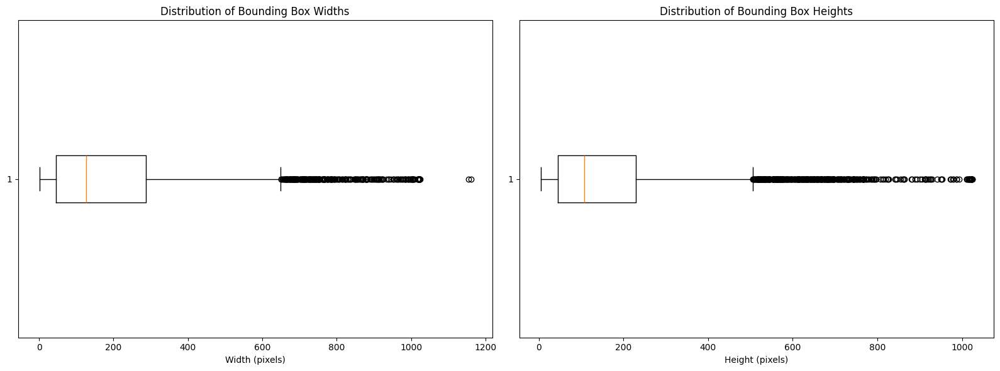

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Create a figure and two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # 1 row, 2 columns

# Distribution of Bounding Box Widths
ax1.boxplot(widths, vert=False, showfliers=True)  # showfliers=True to display outliers
ax1.set_title("Distribution of Bounding Box Widths")
ax1.set_xlabel("Width (pixels)")

# Distribution of Bounding Box Heights
ax2.boxplot(heights, vert=False, showfliers=True)  # showfliers=True to display outliers
ax2.set_title("Distribution of Bounding Box Heights")
ax2.set_xlabel("Height (pixels)")

# Adjust spacing between subplots
plt.tight_layout()

# Display the plots
plt.show()

The box plot of bounding box heights shows that most values are concentrated within a relatively small range, with a median closer to the lower quartile, indicating a skewed distribution. There are many high outliers, meaning some bounding boxes are significantly larger than most others. However, there are almost no low outliers, suggesting that very small bounding boxes are rare

Meanwhile, the data distribution, with many high-value outliers, can negatively impact a deep learning model in several ways:

* Imbalance in Training – The model may learn to prioritize common (smaller) bounding boxes and struggle with larger ones.

* Normalization Issues – Extreme values can distort normalization, compressing most data into a narrow range.

* Generalization Challenges – If the model rarely sees large bounding boxes during training, it may fail to detect them in real scenarios.

To mitigate these issues, we need to consider filtering extreme outliers, or using robust normalization techniques.

For now we will stay with the current data and see how things going.

### Investigate Outliers

We will use a threshold to identify bounding boxes with unusual width, height or aspect ratio, and visualize images corresponding to the outliers to determine their nature. This will help us decide whether they are annotation errors, rare objects, or edge cases.


In [ ]:
import os
import numpy as np

def identify_outlier_bboxes(labels_dir, low_threshold=0, high_threshold=95, aspect_ratio_threshold=5, thresh='high'):
    """
    Identifies outlier bounding boxes and categorizes them by type.
    """

    widths = []
    heights = []
    aspect_ratios = []
    w_h_outliers = []
    aspect_ratio_outliers = []

    for filename in os.listdir(labels_dir):
        if filename.endswith(".txt"):
            label_path = os.path.join(labels_dir, filename)
            with open(label_path, "r") as f:
                for line in f:
                    parts = line.split()
                    x_min, y_min, x_max, y_max = map(float, parts[2:])

                    width = x_max - x_min
                    height = y_max - y_min
                    aspect_ratio = width / height

                    widths.append(width)
                    heights.append(height)
                    aspect_ratios.append(aspect_ratio)

    # Calculate percentiles for width and height
    width_high_percentile = np.percentile(widths, high_threshold)
    height_high_percentile = np.percentile(heights, high_threshold)
    width_low_percentile = np.percentile(widths, low_threshold)
    height_low_percentile = np.percentile(heights, low_threshold)

    # Identify and categorize outliers
    for filename in os.listdir(labels_dir):
        if filename.endswith(".txt"):
            label_path = os.path.join(labels_dir, filename)
            with open(label_path, "r") as f:
                for line in f:
                    parts = line.split()
                    x_min, y_min, x_max, y_max = map(float, parts[2:])

                    width = x_max - x_min
                    height = y_max - y_min
                    aspect_ratio = width / height

                    if thresh == 'high':
                      if aspect_ratio > aspect_ratio_threshold:
                          aspect_ratio_outliers.append((filename.replace(".txt", ".jpg"), (x_min, y_min, x_max, y_max)))
                      elif width > width_high_percentile or height > height_high_percentile:
                          w_h_outliers.append((filename.replace(".txt", ".jpg"), (x_min, y_min, x_max, y_max)))
                    elif thresh == 'low':
                      if aspect_ratio < aspect_ratio_threshold:
                          aspect_ratio_outliers.append((filename.replace(".txt", ".jpg"), (x_min, y_min, x_max, y_max)))
                      elif (width > width_low_percentile and width < width_high_percentile) or (height > height_low_percentile and height < height_high_percentile):
                          w_h_outliers.append((filename.replace(".txt", ".jpg"), (x_min, y_min, x_max, y_max)))


    return w_h_outliers, aspect_ratio_outliers

In [ ]:
# Identify high outliers
w_h_high_outliers, aspect_ratio_high_outliers = identify_outlier_bboxes(labels_dir, high_threshold=95, aspect_ratio_threshold=5, thresh='high')

# Identify low outliers
w_h_low_outliers, aspect_ratio_low_outliers = identify_outlier_bboxes(labels_dir, high_threshold=5, aspect_ratio_threshold=0.2, thresh='low')

# Print the number of outliers in each category
print("High Width & Height Outliers:", len(w_h_high_outliers))
print("High Aspect Ratio Outliers:", len(aspect_ratio_high_outliers))
print("Total High Outliers:", len(w_h_high_outliers) + len(aspect_ratio_high_outliers))

print("\nLow Width & Height Outliers:", len(w_h_low_outliers))
print("Low Aspect Ratio Outliers:", len(aspect_ratio_low_outliers))
print("Total Low Outliers:", len(w_h_low_outliers) + len(aspect_ratio_low_outliers))


High Width & Height Outliers: 420
High Aspect Ratio Outliers: 76
Total High Outliers: 496

Low Width & Height Outliers: 466
Low Aspect Ratio Outliers: 11
Total Low Outliers: 477


Now we will visualy examine samples of the different outlier categories:

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import random

def visualize_outliers(image_dir, labels_dir, outlier_bboxes, images_per_row=4, figsize=(15, 10), num_images_to_print=8):
    """Visualizes images with outlier bounding boxes highlighted."""

    num_images = len(outlier_bboxes)

    # Limit the number of images to print if specified
    if num_images_to_print is not None:
        num_images = min(num_images, num_images_to_print)

    # Select a random sample of images
    random_samples = random.sample(outlier_bboxes, num_images)

    num_rows = (num_images + images_per_row - 1) // images_per_row  # Calculate number of rows

    fig, axes = plt.subplots(num_rows, images_per_row, figsize=figsize)
    fig.tight_layout()  # Adjust spacing between subplots

    for i, (image_filename, bbox) in enumerate(random_samples):  # Iterate over random samples
        image_path = os.path.join(image_dir, image_filename)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Draw the outlier bounding box in red
        x_min, y_min, x_max, y_max = map(int, bbox)
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)

        row = i // images_per_row
        col = i % images_per_row

        # Check if axes is 1-dimensional and access accordingly
        if num_rows == 1 or images_per_row == 1:
            ax = axes[col] if num_rows == 1 else axes[row] #If only one row or one column, access using a single index
        else:
            ax = axes[row, col]  # Access using two indices for 2D structure

        ax.imshow(image)
        ax.set_title(image_filename, fontsize=8)  # Smaller title font size
        ax.axis("off")

    # Hide empty subplots if any
    for i in range(num_images, num_rows * images_per_row):
        row = i // images_per_row
        col = i % images_per_row
        # Check if axes is 1-dimensional and access accordingly
        if num_rows == 1 or images_per_row == 1:
            ax = axes[col] if num_rows == 1 else axes[row] #If only one row or one column, access using a single index
        else:
            ax = axes[row, col]  # Access using two indices for 2D structure
        ax.axis("off")

    plt.tight_layout(pad=0.5)
    plt.show()

Start with high aspect ratio:

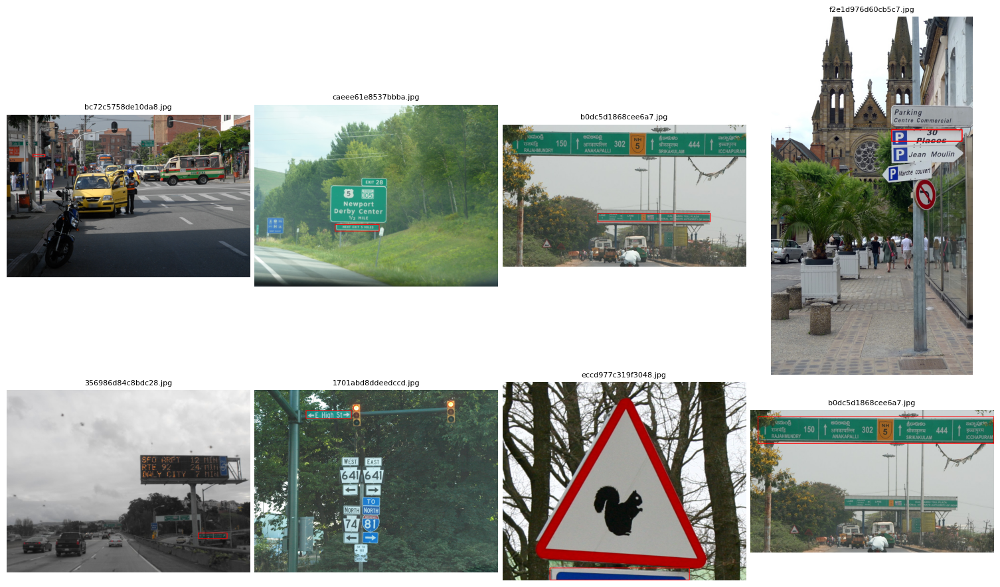

In [ ]:
visualize_outliers(images_dir, labels_dir, aspect_ratio_high_outliers)

We can see that a high aspect ratio (>5) does not necessarily indicate a problem. There are valid signs with high aspect ratios in the dataset

Let's try a higher threshold (>7):

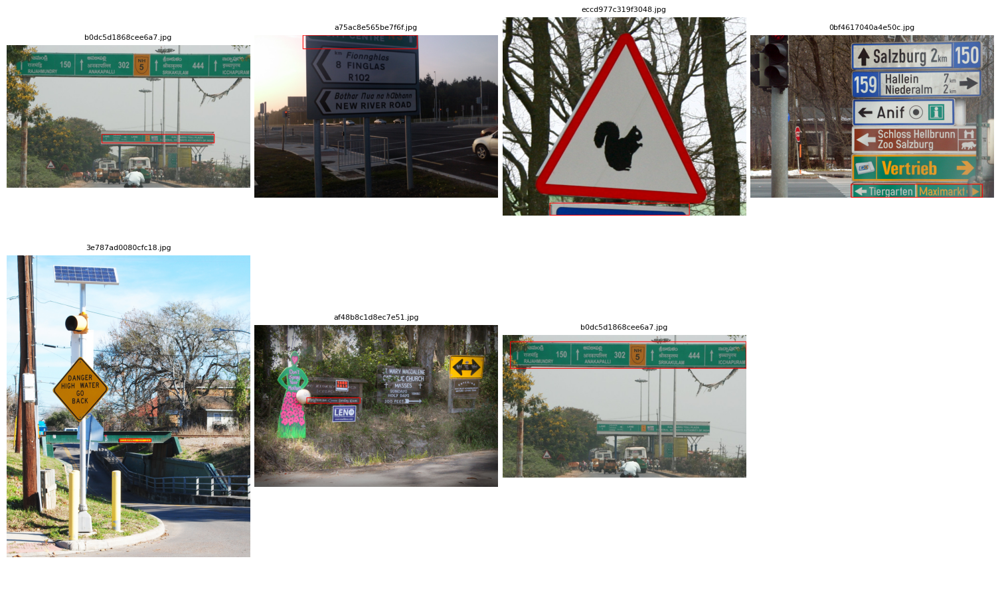

In [ ]:
_, aspect_ratio_higher_outliers = identify_outlier_bboxes(labels_dir, aspect_ratio_threshold=8)
visualize_outliers(images_dir, labels_dir, aspect_ratio_higher_outliers)

**Conclusion**: high aspect ratios do not indicates annotation errors or unusual objects in this dataset.

Let's continue to the large object outliers:

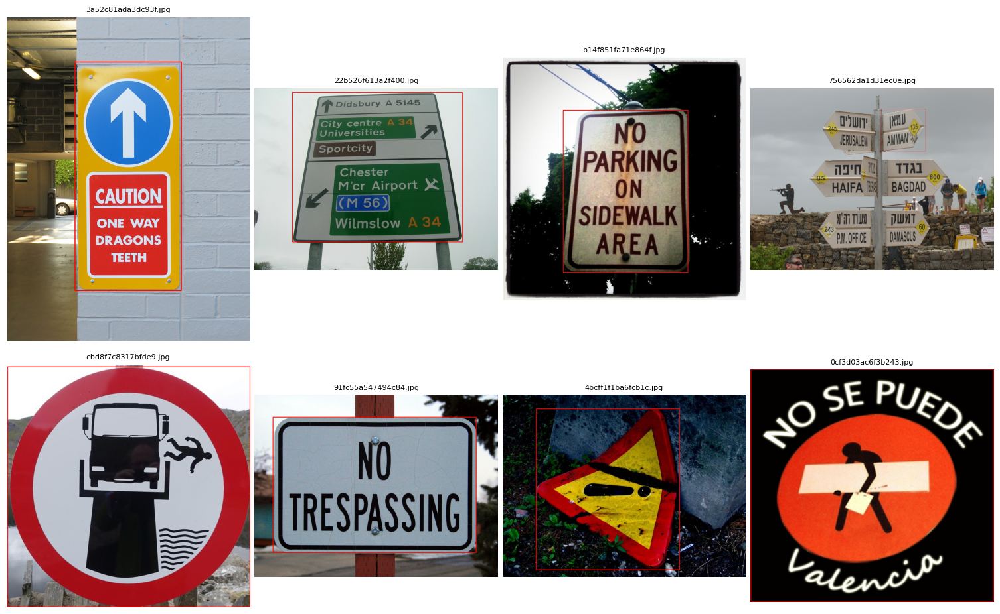

In [ ]:
visualize_outliers(images_dir, labels_dir, w_h_high_outliers)

It appears that the unusually large bounding boxes are a result of the images being taken at close proximity to the objects. This means that the objects occupy a larger portion of the image frame, leading to larger bounding box dimensions.

The bounding boxes are accurately capturing the objects in these close-up images, so there is no inherent problem with the annotations or the dataset itself. The outliers are simply reflecting a particular characteristic of a subset of images within the dataset.

Now to low aspect ratio:

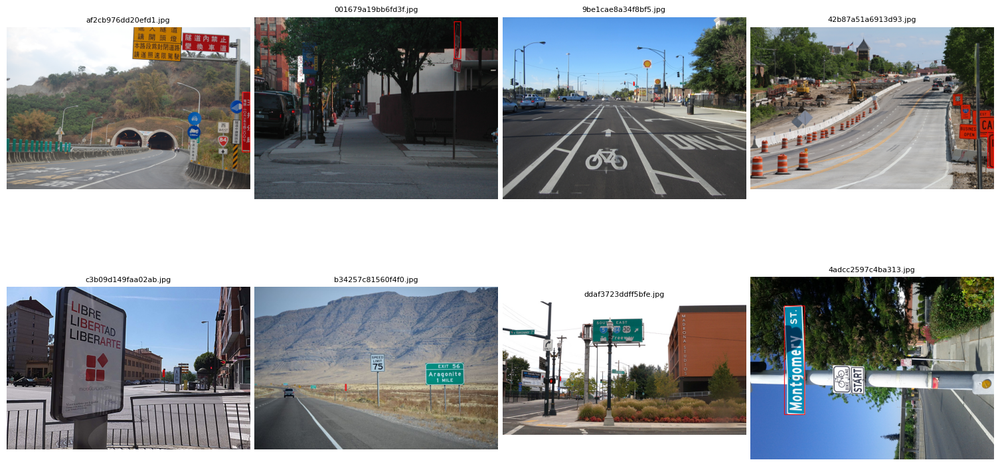

In [ ]:
visualize_outliers(images_dir, labels_dir, aspect_ratio_low_outliers)

The low aspect ratio objects are mainly side-view objects, partially visible objects, and very small objects.

Continue to the smallest objects (width and hight outliers):

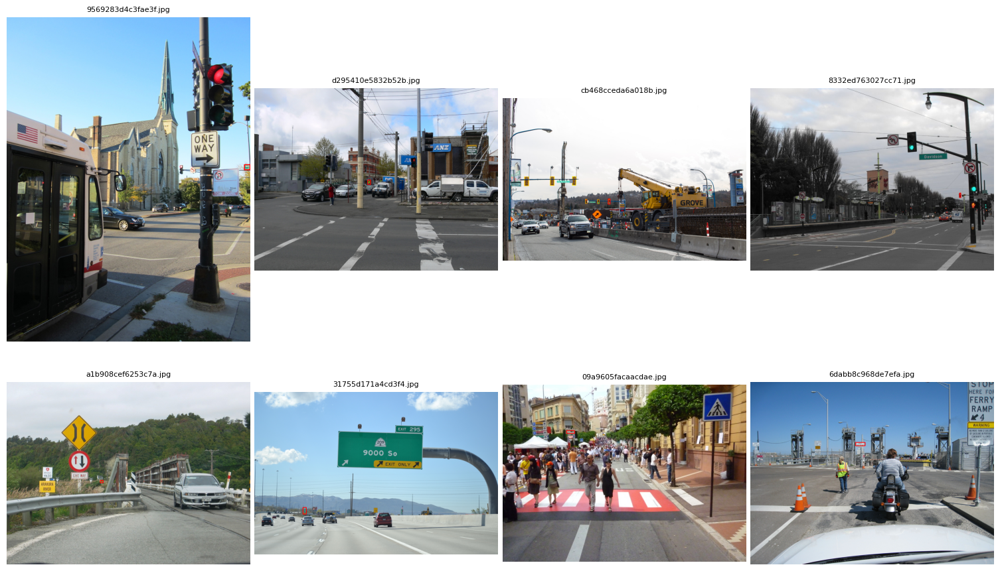

In [ ]:
# Start with default - low 5%
visualize_outliers(images_dir, labels_dir, w_h_low_outliers)

The low 5% objects look very small and not very valuable.

Let's continue to examine higher thresholds for low outliers:

467


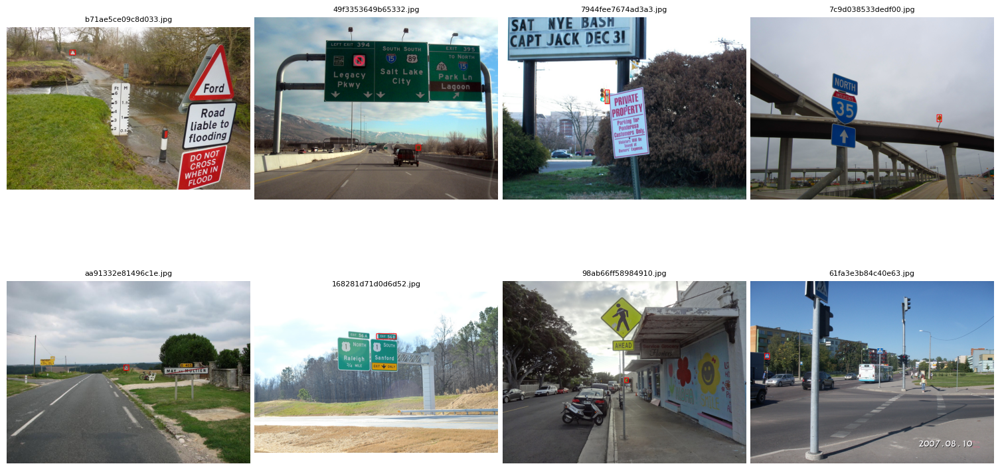

In [ ]:
w_h_low_outliers, _ = identify_outlier_bboxes(labels_dir, low_threshold=5 , high_threshold=10, aspect_ratio_threshold=0, thresh='low')
print(len(w_h_low_outliers))
visualize_outliers(images_dir, labels_dir, w_h_low_outliers)

987


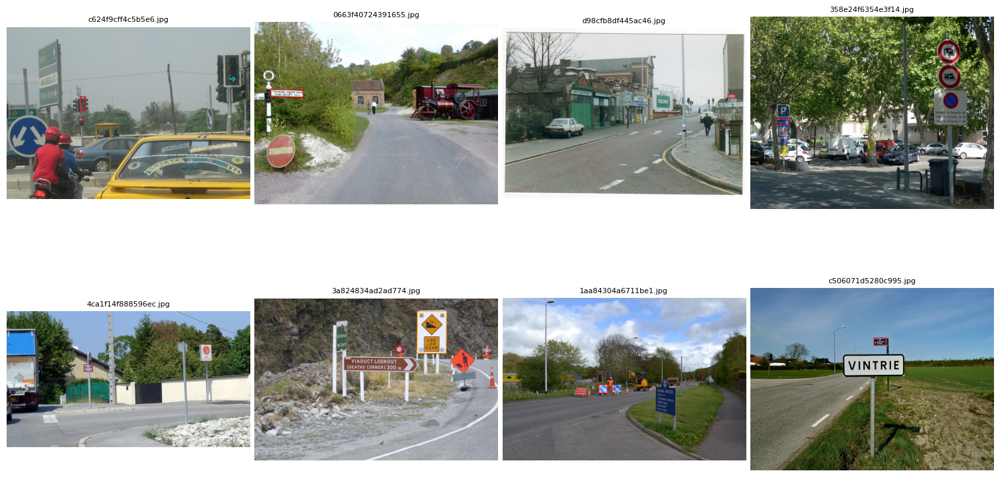

In [ ]:
w_h_low_outliers, _ = identify_outlier_bboxes(labels_dir, low_threshold=10 , high_threshold=20, aspect_ratio_threshold=0, thresh='low')
print(len(w_h_low_outliers))
visualize_outliers(images_dir, labels_dir, w_h_low_outliers)

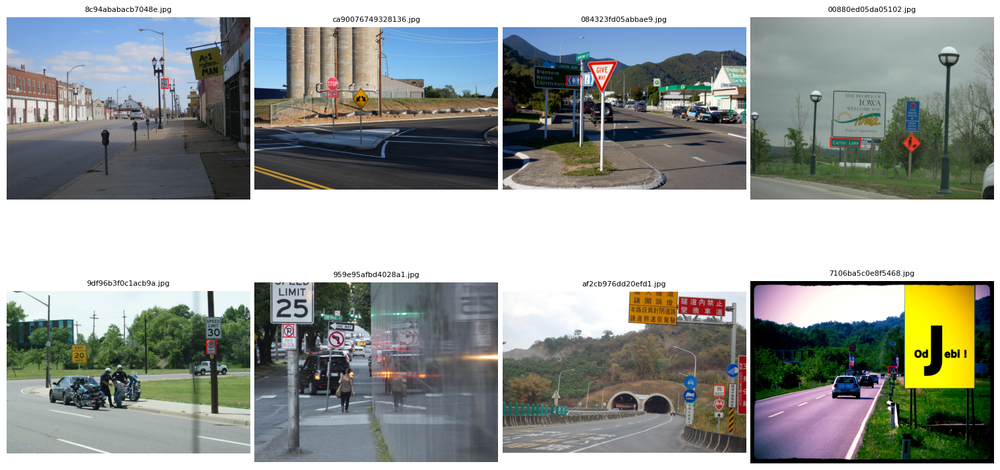

In [ ]:
w_h_low_outliers, _ = identify_outlier_bboxes(labels_dir, low_threshold=20 , high_threshold=25, aspect_ratio_threshold=0, thresh='low')
visualize_outliers(images_dir, labels_dir, w_h_low_outliers)

As for the smaller objects, the visualizations of the dataset have revealed a considerable number of objects that appear small relative to the image size. This observation is based on a visual assessment of the bounding box dimensions and the proportion of the image they occupy.

While these objects are accurately annotated, their small size might pose challenges for object detection models during training and inference. This is a common challenge in object detection, as models tend to perform better with larger and more prominent objects. Therefore, strategies to address this small object problem, such as data augmentation or specialized model architectures, might be needed to improve overall detection performance.

###Object Size Relative to Image

We analyzed object size objectively; now, we continue to analyze its size relative to the image size.

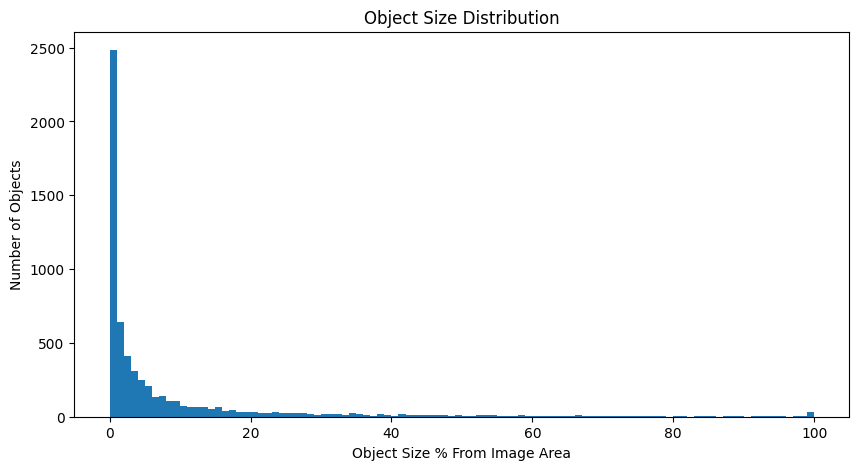

In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np

def calculate_object_size_distribution(images_dir, labels_dir):

  object_sizes = []

  for filename in os.listdir(labels_dir):
    if filename.endswith(".txt"):
      label_path = os.path.join(labels_dir, filename)
      image_path = os.path.join(images_dir, filename.replace(".txt", ".jpg"))

      # Get image dimensions
      img = plt.imread(image_path)

      # Check the number of dimensions in img.shape
      if len(img.shape) == 3:  # If RGB image
          image_height, image_width, _ = img.shape
      elif len(img.shape) == 2:  # If grayscale image
          image_height, image_width = img.shape
      else:
          raise ValueError(f"Unexpected image shape: {img.shape} for image {image_path}")

      image_area = image_height * image_width

      # Read object labels
      with open(label_path, "r") as f:
        for line in f:
          parts = line.split()
          class_name = parts[0] + " " + parts[1]  # Combine the first two elements
          x_min, y_min, x_max, y_max = map(float, parts[2:])

          object_width = x_max - x_min
          object_height = y_max - y_min
          object_area = object_width * object_height

          # Calculate object size relative to image area
          relative_size = object_area / image_area * 100
          object_sizes.append(relative_size)

  return object_sizes

In [ ]:
object_sizes = calculate_object_size_distribution(images_dir, labels_dir)

In [ ]:
import matplotlib.pyplot as plt
def plot_object_size_distribution(object_sizes, min_threshold=0, max_threshold=100):

  # Filter bbox areas based on the defined thresholds
  filtered_object_sizes = [object for object in object_sizes if min_threshold <= object <= max_threshold]

  # Plotting histogram of bounding box areas with specified thresholds
  plt.figure(figsize=(10, 5))
  plt.hist(filtered_object_sizes, bins=50, color='skyblue', edgecolor='black')
  plt.title("Distribution of Bounding Box Areas")
  plt.xlabel("Object Size % From Image Area")
  plt.ylabel("Number of Objects")
  plt.grid(True)
  plt.tight_layout()
  plt.show()

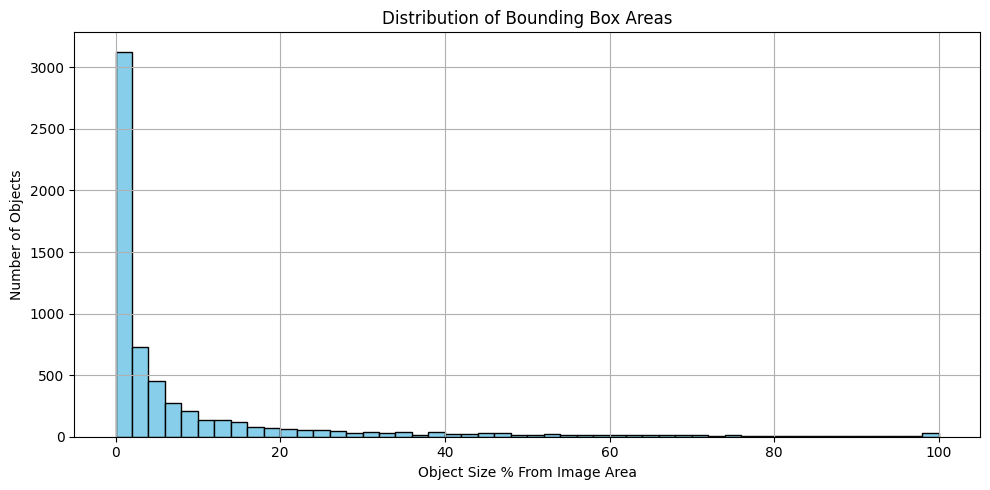

In [ ]:
plot_object_size_distribution(object_sizes)

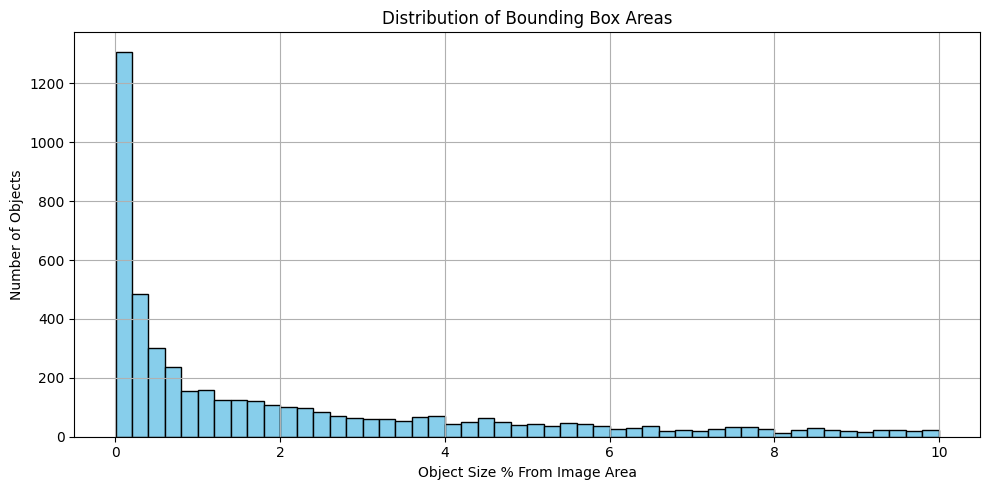

In [ ]:
plot_object_size_distribution(object_sizes,0,10)


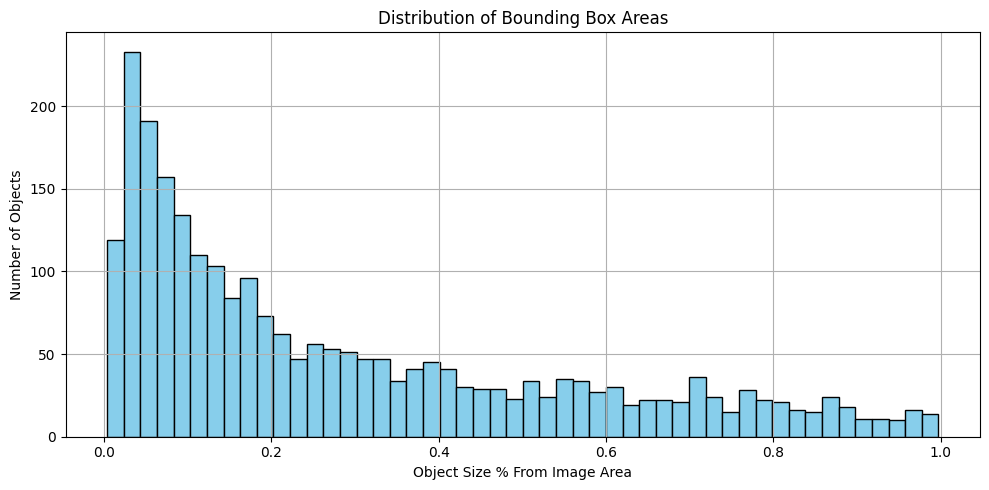

In [ ]:
plot_object_size_distribution(object_sizes,0,1)

The histogram shows that **most objects in the dataset are very small relative to the image size**, with a sharp drop as object size increases. **This distribution can affect the performance of YOLOv11, as object detectors often struggle with small objects** due to limited feature representation.

**Potential Implications**:

- Detection Challenges – Small objects might not contain enough detail for YOLO to detect them reliably.
- High False Negatives (Missed Detections) – The model may struggle to recognize small objects, leading to a higher rate of missed detections.
- Anchor Box Mismatch – YOLO relies on predefined anchor boxes, and if they are not well-suited to the dominant object sizes, detection accuracy may suffer.

**Possible Future Improvements**:

- Custom Anchor Box Tuning – Adjusting anchor box sizes to better match the object distribution may improve detection performance.
- Resolution Scaling – Training on higher-resolution images might help detect small objects more effectively.
- Feature Pyramid Networks (FPN) or PANet – Incorporating multi-scale feature extraction techniques can enhance small object detection.
- Augmentation Strategies – Techniques like random cropping, zooming, and upsampling can improve robustness to small object detection.


**For now, we will proceed with the dataset as it is, and adjustments may be considered later if necessary**

##Characteristics Analysis

### Shapes


Processing image: 20d25f560a03f2f7.jpg


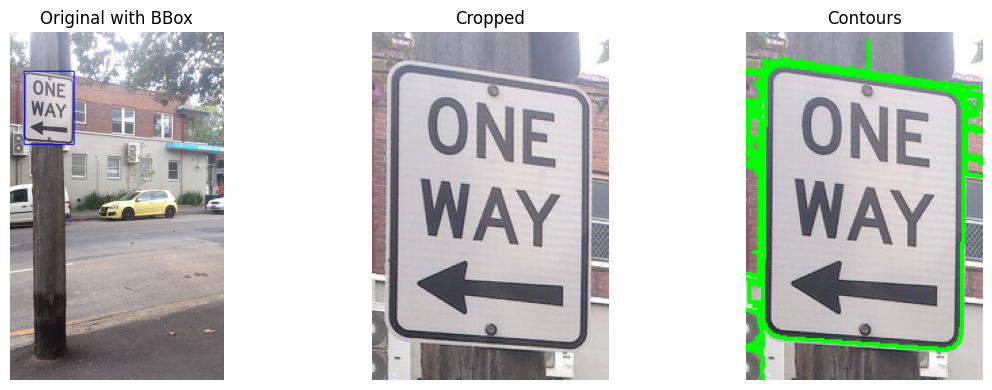


Processing image: 00d0ae2a372fe5e1.jpg


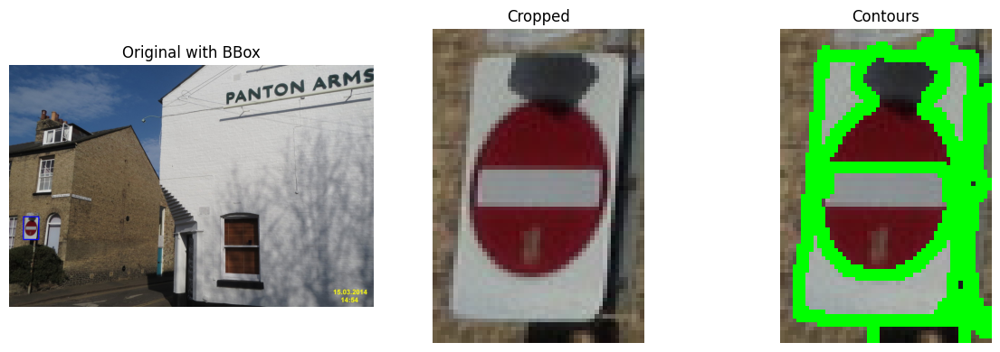


Processing image: ebe73f545761804d.jpg


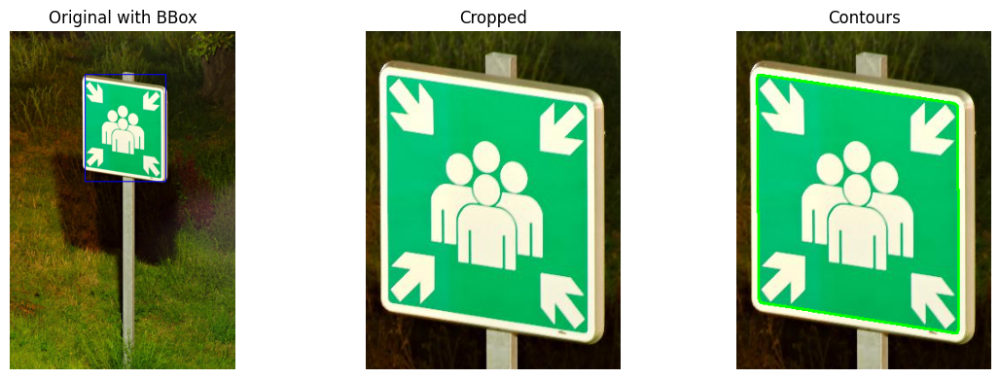


Processing image: 96eda76a3c9b9a9f.jpg


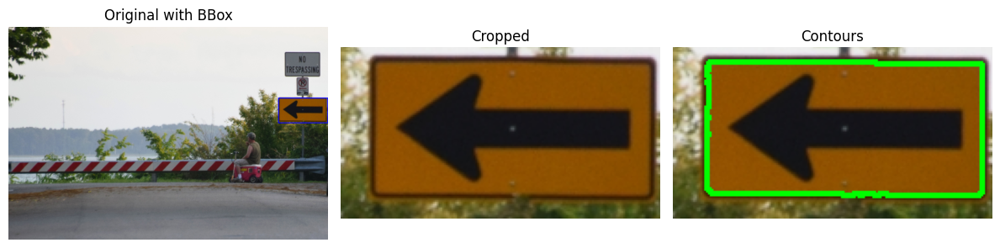

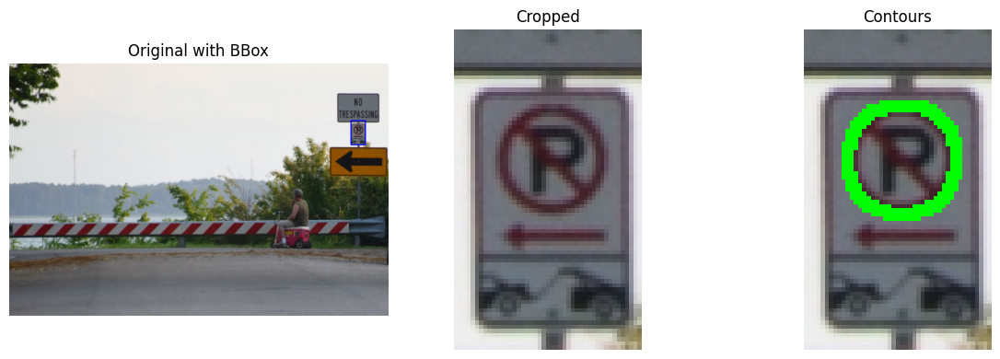

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random



# Directories (lowercase)
images_dir = "/content/images"
labels_dir = "/content/labels"

# Number of images to process
max_images = 5
processed_count = 0

image_files = [f for f in os.listdir(images_dir) if f.endswith((".jpg", ".png"))]
random.shuffle(image_files)

for filename in image_files:
    if not (filename.endswith(".jpg") or filename.endswith(".png")):
        continue

    print(f"\nProcessing image: {filename}")
    image_path = os.path.join(images_dir, filename)
    label_path = os.path.join(labels_dir, os.path.splitext(filename)[0] + ".txt")

    if not os.path.exists(label_path):
        print(f"→ Label file not found: {label_path}")
        continue

    image = cv2.imread(image_path)
    if image is None:
        print(f"→ Failed to read image: {image_path}")
        continue

    image_height, image_width = image.shape[:2]

    with open(label_path, 'r') as f:
        lines = f.readlines()

    if not lines:
        print(f"→ Label file is empty: {label_path}")
        continue

    found_valid_object = False

    for line in lines:
        line = line.strip()
        if not line.startswith("Traffic sign"):
            continue

        line = line.replace("Traffic sign", "").strip()
        parts = line.split()
        if len(parts) != 4:
            continue

        try:
            x_min, y_min, x_max, y_max = [int(float(v)) for v in parts]
        except ValueError:
            print(f"→ Invalid bounding box values: {parts}")
            continue

        # Clamp values
        x_min = max(0, min(x_min, image_width - 1))
        x_max = max(0, min(x_max, image_width - 1))
        y_min = max(0, min(y_min, image_height - 1))
        y_max = max(0, min(y_max, image_height - 1))

        if x_max <= x_min or y_max <= y_min:
            continue

        # Draw bbox on original image
        image_with_bbox = image.copy()
        cv2.rectangle(image_with_bbox, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)

        # Add padding (e.g., 10%)
        padding_ratio = 0.1

        bbox_width = x_max - x_min
        bbox_height = y_max - y_min

        x_pad = int(bbox_width * padding_ratio)
        y_pad = int(bbox_height * padding_ratio)

        # Expand bbox with clamping
        x1 = max(0, x_min - x_pad)
        y1 = max(0, y_min - y_pad)
        x2 = min(image_width - 1, x_max + x_pad)
        y2 = min(image_height - 1, y_max + y_pad)

        cropped = image[y1:y2, x1:x2]
        if cropped.size == 0:
            continue

        # Convert to grayscale and detect contours
        gray = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)
        edges = cv2.Canny(gray, 50, 150)
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        if not contours:
            continue

        # Draw contours on cropped image
        output = cropped.copy()
        # Find the largest contour (by area)
        largest_contour = max(contours, key=cv2.contourArea)

        # Draw only the largest contour
        cv2.drawContours(output, [largest_contour], -1, (0, 255, 0), 2)

        # Display results
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.title("Original with BBox")
        plt.imshow(cv2.cvtColor(image_with_bbox, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.title("Cropped")
        plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.title("Contours")
        plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        found_valid_object = True
        processed_count += 1
        if processed_count >= max_images:
            break

    if not found_valid_object:
        print("→ No valid objects found in this image.")

    if processed_count >= max_images:
        break


Despite various attempts and refinements to analyze traffic sign shapes within the dataset, achieving reliable and high-quality shape characterization proved unfeasible. This limitation stems from several factors, including the presence of complex shapes, the prevalence of small objects with low resolution, and inherent limitations in the capabilities of the utilized tool for shape feature extraction. Consequently, further investigation into shape-based analysis for this dataset is deemed unproductive, and alternative approaches for improving detection performance should be explored.

### Colors

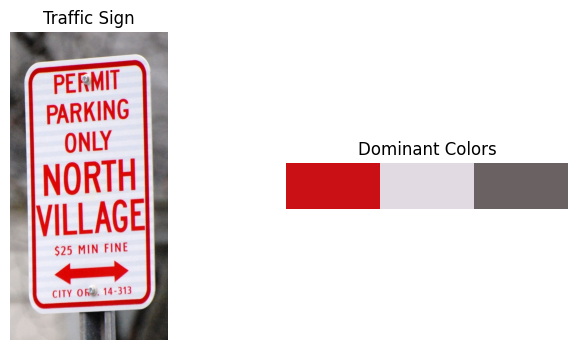

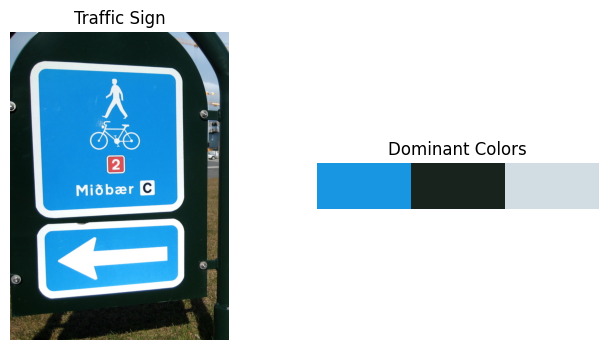

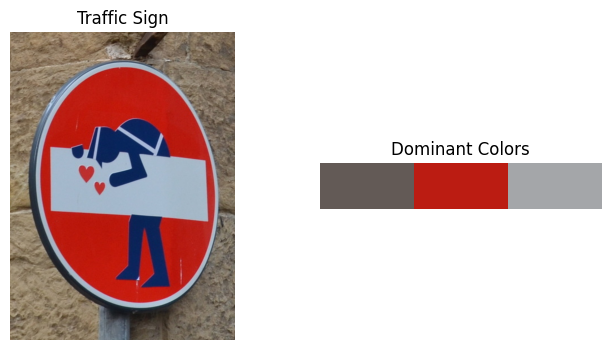

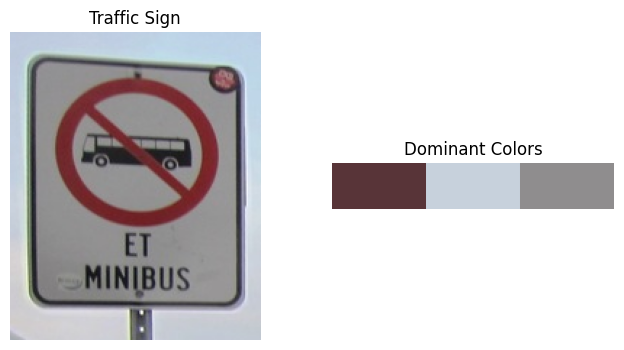

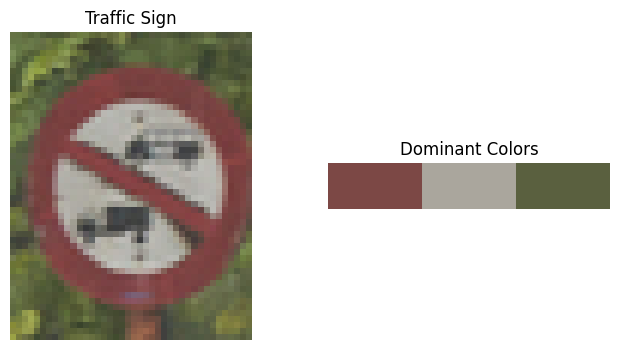

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import random

# Directories (edit if needed)
images_dir = "/content/images"
labels_dir = "/content/labels"

# Parameters
max_images = 5
padding_ratio = 0.1
k_clusters = 3

image_files = [f for f in os.listdir(images_dir) if f.endswith((".jpg", ".png"))]
random.shuffle(image_files)

def show_dominant_colors(image, colors, title="Dominant Colors"):
    plt.figure(figsize=(8, 4))

    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Traffic Sign")

    plt.subplot(1, 2, 2)
    palette = np.zeros((50, 300, 3), dtype=np.uint8)
    step = 300 // len(colors)
    for i, color in enumerate(colors):
        palette[:, i*step:(i+1)*step] = np.uint8(color)
    plt.imshow(cv2.cvtColor(palette, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(title)
    plt.show()

count = 0
for filename in image_files:
    if count >= max_images:
        break

    image_path = os.path.join(images_dir, filename)
    label_path = os.path.join(labels_dir, os.path.splitext(filename)[0] + ".txt")

    if not os.path.exists(label_path):
        continue

    image = cv2.imread(image_path)
    if image is None:
        continue

    image_height, image_width = image.shape[:2]

    with open(label_path, "r") as f:
        lines = f.readlines()

    for line in lines:
        line = line.strip()
        if not line.startswith("Traffic sign"):
            continue

        line = line.replace("Traffic sign", "").strip()
        parts = line.split()
        if len(parts) != 4:
            continue

        try:
            x_min, y_min, x_max, y_max = [int(float(v)) for v in parts]
        except ValueError:
            print(f"→ Invalid bounding box values: {parts}")
            continue

        x_min, x_max = int(x_min), int(x_max)
        y_min, y_max = int(y_min), int(y_max)

        # Add padding
        bbox_width = x_max - x_min
        bbox_height = y_max - y_min
        x_pad = int(bbox_width * padding_ratio)
        y_pad = int(bbox_height * padding_ratio)
        x1 = max(0, x_min - x_pad)
        y1 = max(0, y_min - y_pad)
        x2 = min(image_width - 1, x_max + x_pad)
        y2 = min(image_height - 1, y_max + y_pad)

        cropped = image[y1:y2, x1:x2]
        if cropped.size == 0:
            continue

        # Reshape and filter
        pixels = cropped.reshape(-1, 3)
        pixels = pixels[np.any(pixels < 250, axis=1)]  # Remove white-ish pixels

        if len(pixels) < k_clusters:
            continue

        # KMeans clustering
        kmeans = KMeans(n_clusters=k_clusters, n_init="auto", random_state=42)
        kmeans.fit(pixels)
        dominant_colors = kmeans.cluster_centers_

        # Show
        show_dominant_colors(cropped, dominant_colors)
        count += 1
        break


Regarding the analysis of traffic sign colors, extensive examination of various examples has led to the conclusion that classifying sign colors holds limited value for this dataset. This is primarily due to the wide diversity of sign types, with many signs exhibiting multiple colors and intricate shapes. Furthermore, the presence of non-standard traffic-related objects, coupled with small, low-resolution objects, further complicates the process of reliable color-based classification. Therefore, focusing on color-based analysis for this particular dataset is deemed unproductive, and alternative approaches for enhancing detection performance should be prioritized."

# Data Preperation

Before we can start training the YOLO model, we need to prepare the data in a format that YOLO can understand. This includes Label format conversion, data splitting and creaing configuration file.

## Label Format Conversion

First, we need to ensure that the labels are in the correct format. The original label format obtained from the Open Images V7 dataset is different from the format required by the YOLO framework.

The Open Images V7 dataset provides bounding box annotations in the following format:

**class_name x_min y_min x_max y_max**

While the YOLO framework expects bounding box annotations in the following format:

**class_id center_x center_y width height**

This conversion process involves transforming the bounding box coordinates and class information into the specific structure expected by YOLO. The following code cells will handle this conversion, ensuring that the labels are compatible with the YOLO model for training.


In [ ]:
import os
from PIL import Image

def get_image_dimensions(image_path):
    """Gets the width and height of an image."""
    with Image.open(image_path) as img:
        width, height = img.size
    return width, height

def convert_to_yolo_format(label_line, image_width, image_height):
    """Converts a label line to YOLO format (single class)."""
    parts = label_line.split()
    x_min, y_min, x_max, y_max = map(float, parts[2:])

    # Calculate center, width, and height
    center_x = (x_min + x_max) / 2 / image_width
    center_y = (y_min + y_max) / 2 / image_height
    width = (x_max - x_min) / image_width
    height = (y_max - y_min) / image_height

    # Single class, so class_id is always 0
    class_id = 0

    return f"{class_id} {center_x} {center_y} {width} {height}"

def convert_labels_to_yolo(images_dir, labels_dir):
    """Converts all labels to YOLO format (single class), replacing existing files."""

    for filename in os.listdir(labels_dir):
        if filename.endswith(".txt"):
            label_path = os.path.join(labels_dir, filename)
            image_path = os.path.join(images_dir, filename.replace(".txt", ".jpg"))

            image_width, image_height = get_image_dimensions(image_path)

            # Create a temporary file to store converted lines
            temp_file_path = label_path + ".tmp"
            with open(label_path, "r") as infile, open(temp_file_path, "w") as outfile:
                for line in infile:
                    yolo_line = convert_to_yolo_format(line, image_width, image_height)
                    outfile.write(yolo_line + "\n")

            # Replace the original file with the temporary file
            os.replace(temp_file_path, label_path)

convert_labels_to_yolo(images_dir, labels_dir)

To ensure the conversion was successful, we will examine a few converted label files and visually inspect the bounding boxes on sample images. This will help us verify that the annotations are correctly represented in the YOLO format.

In [ ]:
# Examine a few label files
for i, filename in enumerate(os.listdir(labels_dir)[:5]):  # Examine the first 5 files
    if filename.endswith(".txt"):
        label_path = os.path.join(labels_dir, filename)
        print(f"--- Contents of {filename} ---")
        with open(label_path, "r") as f:
            for line in f:
                print(line.strip())  # Print each line without extra whitespace
        print("\n")  # Add an empty line between files

--- Contents of 0101abaff92fa0b2.txt ---
0 0.5484375 0.4883335 0.514375 0.7116669999999999


--- Contents of 27ee34e8e4de0f8b.txt ---
0 0.530236 0.5384374999999999 0.08406999999999999 0.05312499999999998
0 0.6084069999999999 0.5453125 0.07227199999999995 0.02562500000000001


--- Contents of ae1639138ec7ae08.txt ---
0 0.5033329999999999 0.5640625 0.9500000000000001 0.6443749999999999


--- Contents of 508166b162fe18b0.txt ---
0 0.24625 0.4529165 0.034999999999999976 0.08083300000000009
0 0.7571875 0.48041700000000004 0.04937499999999995 0.07750000000000012


--- Contents of b8309756fd658c32.txt ---
0 0.5053125 0.4870295 0.45062499999999994 0.579079




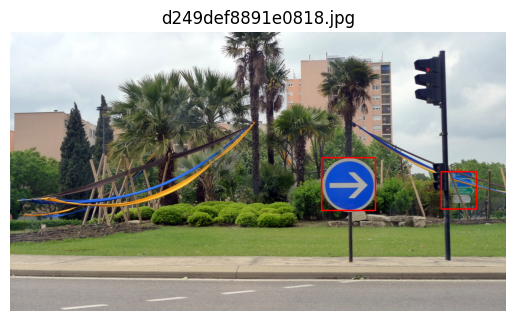

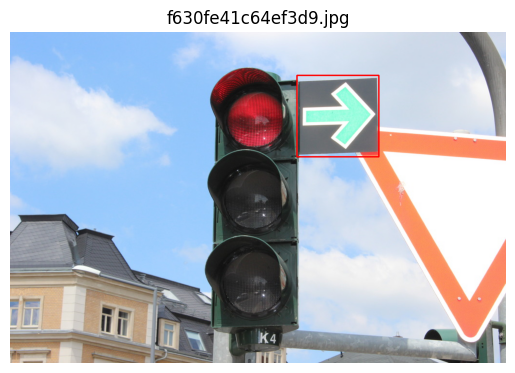

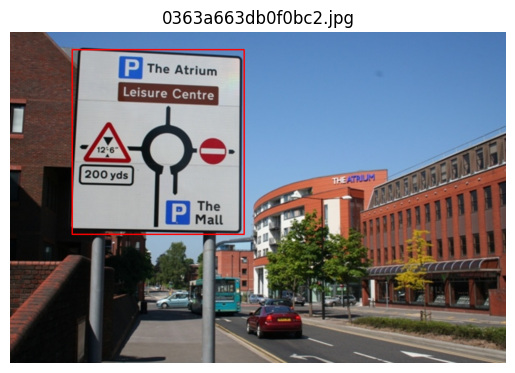

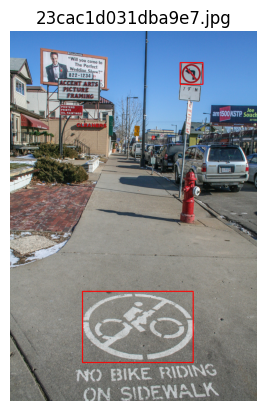

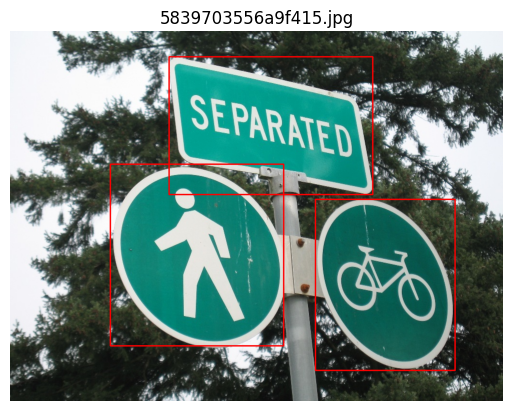

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt

def visualize_random_yolo_images(image_dir, labels_dir, num_images=5):
    """Visualizes a random set of images with YOLO bounding boxes."""

    image_filenames = [f for f in os.listdir(image_dir) if f.endswith(".jpg")]
    random_images = random.sample(image_filenames, num_images)

    for image_filename in random_images:
        image_path = os.path.join(image_dir, image_filename)
        label_path = os.path.join(labels_dir, image_filename.replace(".jpg", ".txt"))

        # Load the image
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB

        # Read bounding box information from the label file
        with open(label_path, "r") as f:
            for line in f:
                parts = line.split()
                class_id, center_x, center_y, width, height = map(float, parts)

                # Get image dimensions
                image_height, image_width, _ = image.shape

                # Calculate bounding box coordinates
                x_min = int((center_x - width / 2) * image_width)
                y_min = int((center_y - height / 2) * image_height)
                x_max = int((center_x + width / 2) * image_width)
                y_max = int((center_y + height / 2) * image_height)

                # Draw the bounding box
                cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (255, 0, 0), 2)

        # Display the image
        plt.imshow(image)
        plt.title(image_filename)
        plt.axis("off")
        plt.show()

# Example usage:
visualize_random_yolo_images(images_dir, labels_dir)  # Visualize 5 random images

This validation process confirmed that the annotations are correctly represented in the YOLO format and ready for model training.

##Data Splitting

Now, we need to further prepare the data by splitting it into train, validation, and test sets and organizing it into a specific folder structure that YOLO expects.

In [ ]:
#install the split-folders library, which will be used to split the dataset into train, validation, and test sets.
!pip install split-folders

In [ ]:
# Move the images and labels folders into a new directory

import shutil
import os

# Define the source and destination paths
source_images_dir = "/content/images"
source_labels_dir = "/content/labels"
destination_dir = "/content/data"

# Create the destination directory if it doesn't exist
os.makedirs(destination_dir, exist_ok=True)

# Move the images folder
shutil.move(source_images_dir, destination_dir)

# Move the labels folder
shutil.move(source_labels_dir, destination_dir)

'/content/data/labels'

We will split the dataset into train, validation, and test sets with a ratio of 70%, 20%, and 10%, respectively:

In [ ]:
import splitfolders

input_folder = "/content/data"
output_folder = "/content/split_data"
splitfolders.ratio(input_folder, output=output_folder, seed=1337, ratio=(0.7, 0.2, 0.1))

Copying files: 5634 files [00:01, 3013.20 files/s]


Create the specific folder structure expected by YOLO:

In [ ]:
import shutil
import os

# Define source and destination paths
source_dir = "/content/split_data"
yolo_dataset_dir = "/content/yolo_dataset"  # Create a new folder for YOLO dataset

# Create the YOLO dataset directory structure if it doesn't exist
os.makedirs(os.path.join(yolo_dataset_dir, "images", "train"), exist_ok=True)
os.makedirs(os.path.join(yolo_dataset_dir, "images", "val"), exist_ok=True)
os.makedirs(os.path.join(yolo_dataset_dir, "images", "test"), exist_ok=True)
os.makedirs(os.path.join(yolo_dataset_dir, "labels", "train"), exist_ok=True)
os.makedirs(os.path.join(yolo_dataset_dir, "labels", "val"), exist_ok=True)
os.makedirs(os.path.join(yolo_dataset_dir, "labels", "test"), exist_ok=True)

# Move images and labels to the corresponding YOLO dataset folders
for data_type in ["train", "val", "test"]:
    shutil.move(os.path.join(source_dir, data_type, "images"),
                os.path.join(yolo_dataset_dir, "images", data_type))
    shutil.move(os.path.join(source_dir, data_type, "labels"),
                os.path.join(yolo_dataset_dir, "labels", data_type))



In [ ]:
import shutil
import os

def consolidate_folders(root_dir):
    for data_type in ['train', 'val', 'test']:
        # Path to the extra images folder
        extra_images_dir = os.path.join(root_dir, 'images', data_type, 'images')
        # Path to the correct destination folder
        dest_images_dir = os.path.join(root_dir, 'images', data_type)

        # If the extra images folder exists, move its contents to the correct folder
        if os.path.exists(extra_images_dir):
            for filename in os.listdir(extra_images_dir):
                src_path = os.path.join(extra_images_dir, filename)
                dest_path = os.path.join(dest_images_dir, filename)
                shutil.move(src_path, dest_path)

            # Remove the now empty extra images folder
            os.rmdir(extra_images_dir)

# Adjust the path if needed
yolo_dataset_dir = '/content/yolo_dataset'

consolidate_folders(yolo_dataset_dir)

In [ ]:
import shutil
import os

# Define the source and destination paths
source_dir = "/content/content/yolo_dataset"
destination_dir = "/content/yolo_dataset"

# Move the yolo_dataset folder
shutil.move(source_dir, destination_dir)

'/content/yolo_dataset'

### Split Validation

* Count the number of images and labels in each split (train, validation, test) of the YOLO dataset. This helps verify that the data has been split and organized correctly.

In [ ]:
import os

def count_files_in_yolo_dataset(dataset_path):
    """Counts the number of images and labels in each split of the YOLO dataset."""

    splits = ["train", "val", "test"]
    file_types = ["images", "labels"]
    counts = {}

    for split in splits:
        counts[split] = {}
        for file_type in file_types:
            folder_path = os.path.join(dataset_path, file_type, split)
            num_files = len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])
            counts[split][file_type] = num_files

    return counts

# Example usage:
dataset_path = "/content/yolo_dataset"  # Replace with your dataset path
file_counts = count_files_in_yolo_dataset(dataset_path)

for split, split_counts in file_counts.items():
    print(f"Split: {split}")
    for file_type, count in split_counts.items():
        print(f"  Number of {file_type}: {count}")

Split: train
  Number of images: 1971
  Number of labels: 1972
Split: val
  Number of images: 563
  Number of labels: 563
Split: test
  Number of images: 283
  Number of labels: 283


* Ensure that every image in your dataset has a corresponding label file (and vice versa)

In [ ]:
import os

def compare_image_label_names(dataset_path):
    """Compares image names and label names for all 3 sets in the YOLO dataset."""

    splits = ["train", "val", "test"]
    mismatches = {}

    for split in splits:
        image_dir = os.path.join(dataset_path, "images", split)  # Path to images for the split
        label_dir = os.path.join(dataset_path, "labels", split)  # Path to labels for the split

        # Get sets of image and label filenames without extensions
        image_files = set(f.split('.')[0] for f in os.listdir(image_dir) if f.endswith('.jpg'))
        label_files = set(f.split('.')[0] for f in os.listdir(label_dir) if f.endswith('.txt'))

        # Find mismatches
        missing_labels = image_files - label_files  # Images without corresponding labels
        missing_images = label_files - image_files  # Labels without corresponding images

        mismatches[split] = {
            "missing_labels": list(missing_labels),
            "missing_images": list(missing_images)
        }

    return mismatches

# Example usage:
dataset_path = "/content/yolo_dataset"  # Replace with your dataset path
mismatches = compare_image_label_names(dataset_path)

for split, split_mismatches in mismatches.items():
    print(f"Split: {split}")
    print(f"  Missing labels for images: {split_mismatches['missing_labels']}")
    print(f"  Missing images for labels: {split_mismatches['missing_images']}")

Split: train
  Missing labels for images: []
  Missing images for labels: []
Split: val
  Missing labels for images: []
  Missing images for labels: []
Split: test
  Missing labels for images: []
  Missing images for labels: []


##Create configuration file

YOLO expects a configuration file called data.yaml that specifies the paths to the data, the number of classes, and the class names.

In [ ]:
# Create data.yaml file
data_yaml_path = os.path.join(yolo_dataset_dir, "data.yaml")
with open(data_yaml_path, "w") as f:
    f.write(f"train: {os.path.join(yolo_dataset_dir, 'images', 'train')}\n")
    f.write(f"val: {os.path.join(yolo_dataset_dir, 'images', 'val')}\n")
    f.write(f"test: {os.path.join(yolo_dataset_dir, 'images', 'test')}\n\n")
    f.write("nc: 1\n")  #  number of classes
    f.write("names: ['sign']")  # class names

In [ ]:
# Save the prepared data in Google Drive
!zip -r /content/drive/MyDrive/yolo_dataset_ready.zip /content/yolo_dataset

#Model Training

After meticulously preparing and validating the dataset, we now embark on the crucial phase of model training. This stage involves using the prepared dataset to train a YOLO object detection model, enabling it to recognize and locate traffic signs within images. The goal is to develop a robust and accurate model capable of performing well on unseen data.

First we load and organize the data

In [ ]:
!unzip -q /content/drive/MyDrive/yolo_dataset_ready.zip

In [ ]:
import shutil
import os

# Define the source and destination paths
source_dir = "/content/content/yolo_dataset"
destination_dir = "/content/yolo_dataset"

# Check if the source directory exists
if os.path.exists(source_dir):
  # Move the directory
  shutil.move(source_dir, destination_dir)
  print(f"Moved '{source_dir}' to '{destination_dir}'")
else:
  print(f"Source directory '{source_dir}' not found.")

Moved '/content/content/yolo_dataset' to '/content/yolo_dataset'


##Training Setup

This code initializes a YOLOv11n model and sets up the training process.

Let's examine the chosen parameters and the rationale behind their selection:


* **epochs=100**: We train the model for 100 epochs, allowing it sufficient iterations to learn the patterns and features within the data. While a larger number of epochs could potentially lead to better performance, it also increases the risk of overfitting. We chose 100 epochs as a reasonable balance between training duration and model generalization.

* **patience=20**: To prevent overfitting and ensure generalization, we implement early stopping with a patience of 20 epochs. This means if the model's performance on the validation set doesn't improve for 20 consecutive epochs, the training process will be halted. This helps to find a good balance between model complexity and its ability to generalize to new data.

* **imgsz=640**: We set the input image size to 640 pixels. This value is chosen as a common resolution for object detection tasks, providing a balance between computational efficiency and the ability to capture sufficient details in the images. YOLOv11n performs well with this input size, and resizing the images to this dimension ensures consistency during training.

**Default Parameters and Rationale:**

Several other training parameters remain at their default values, as defined by the Ultralytics YOLO library. This decision is based on the library's recommendations and empirical observations in the object detection domain:

* **Optimizer**: The Adam optimizer is used by default. It is a widely adopted and effective optimizer for deep learning models, offering adaptive learning rates and momentum-based updates.

* **Batch size**: The default batch size is automatically determined based on available GPU memory. This dynamic adjustment ensures efficient utilization of resources while maintaining a reasonable training speed.

* **Learning rate**: The default learning rate schedule is employed. Ultralytics YOLO implements a learning rate scheduler that gradually reduces the learning rate during training, helping the model converge to an optimal solution.

**Augmentation**: The Ultralytics YOLO library automatically applies standard data augmentation techniques during training. These techniques, such as random cropping, flipping, and color adjustments, help to increase the diversity of the training data and improve the model's robustness and ability to generalize to unseen data.

By carefully selecting these training parameters and leveraging the default settings, along with the inherent capabilities of the YOLOv11n architecture, we aim to achieve optimal performance for traffic sign detection. This approach combines best practices from the Ultralytics library with considerations specific to our dataset and task, paving the way for a robust and accurate object detection model.

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 974.8/974.8 kB 54.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 113.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 89.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 41.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 96.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninst

In [ ]:
from ultralytics import YOLO
import os

model = YOLO('yolo11n')  # Load the YOLOv11n model

save_dir = "/content/drive/MyDrive/yolo_training"

results = model.train(data='/content/yolo_dataset/data.yaml', epochs=100, patience=20, imgsz=640, save_dir=save_dir)

Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/yolo_dataset/data.yaml, epochs=100, time=None, patience=20, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sho

train: Scanning /content/yolo_dataset/labels/train.cache... 1971 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1971/1971 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/yolo_dataset/labels/val.cache... 563 images, 0 backgrounds, 0 corrupt: 100%|██████████| 563/563 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.66G     0.9414      1.857      1.081         12        640: 100%|██████████| 124/124 [00:16<00:00,  7.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  6.55it/s]


                   all        563       1342      0.564      0.449      0.469       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.65G      1.045      1.442      1.155         13        640: 100%|██████████| 124/124 [00:15<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  6.95it/s]


                   all        563       1342      0.589      0.504      0.509      0.337

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.69G      1.114      1.362      1.186         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.24it/s]

                   all        563       1342      0.365      0.358      0.287      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.71G      1.108      1.256      1.184          8        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.24it/s]

                   all        563       1342      0.628      0.589      0.573      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      4.67G      1.082      1.139      1.165         24        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.36it/s]

                   all        563       1342      0.631      0.488      0.514      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      4.68G      1.039      1.094      1.161         12        640: 100%|██████████| 124/124 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.13it/s]

                   all        563       1342       0.67      0.626       0.63      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.67G      1.028      1.054      1.141         13        640: 100%|██████████| 124/124 [00:15<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.54it/s]

                   all        563       1342      0.656      0.623      0.624      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100       4.7G     0.9941      1.036      1.118         10        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.36it/s]

                   all        563       1342      0.719      0.635      0.656      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.65G     0.9934     0.9957      1.125         13        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.43it/s]

                   all        563       1342        0.7      0.599      0.642      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      4.68G     0.9649     0.9681      1.108         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.39it/s]

                   all        563       1342      0.654      0.613      0.631      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.68G     0.9519     0.9462      1.095         18        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.44it/s]

                   all        563       1342      0.705      0.618      0.656      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       4.7G     0.9606     0.9509      1.098         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.51it/s]

                   all        563       1342      0.714      0.628      0.671      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.67G     0.9265     0.9218      1.084          9        640: 100%|██████████| 124/124 [00:15<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.43it/s]

                   all        563       1342      0.727      0.631      0.681      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.67G     0.9489     0.9342      1.088          4        640: 100%|██████████| 124/124 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.43it/s]

                   all        563       1342      0.707       0.65      0.675      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.67G     0.9273     0.9125      1.074          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.19it/s]

                   all        563       1342      0.705      0.631      0.674      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.62G     0.9151        0.9      1.074         10        640: 100%|██████████| 124/124 [00:15<00:00,  8.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.33it/s]

                   all        563       1342      0.687      0.659      0.685      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.71G     0.9315     0.9082      1.082         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.25it/s]

                   all        563       1342      0.726      0.679      0.711      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.67G     0.9093     0.8775      1.069         19        640: 100%|██████████| 124/124 [00:15<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.54it/s]

                   all        563       1342      0.739      0.668      0.703      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.66G     0.8954     0.8692      1.059         16        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.21it/s]

                   all        563       1342       0.72      0.662      0.692      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.67G     0.8895      0.836      1.062          6        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.41it/s]

                   all        563       1342      0.747      0.659      0.712       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.68G     0.8811     0.8277      1.062         10        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.40it/s]

                   all        563       1342      0.704      0.684      0.703      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.67G     0.8852     0.8406      1.054          6        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.53it/s]

                   all        563       1342      0.695      0.679      0.702      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       4.7G     0.8753     0.8175      1.057          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.51it/s]

                   all        563       1342      0.735      0.667      0.706      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.67G     0.8734     0.8377      1.044          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.45it/s]

                   all        563       1342      0.729      0.664      0.699      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       4.7G     0.8676     0.8092      1.043         17        640: 100%|██████████| 124/124 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.45it/s]

                   all        563       1342      0.733      0.652      0.703      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      4.67G     0.8584     0.8025      1.036          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.53it/s]

                   all        563       1342      0.729      0.642      0.698      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.67G     0.8762     0.8156      1.049         16        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.49it/s]

                   all        563       1342      0.713      0.686      0.717      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.67G     0.8461     0.7901      1.035         31        640: 100%|██████████| 124/124 [00:15<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.29it/s]

                   all        563       1342      0.723      0.682      0.713      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.68G     0.8567     0.8093      1.039          9        640: 100%|██████████| 124/124 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.57it/s]

                   all        563       1342       0.75      0.627      0.703      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.67G     0.8368      0.777      1.034         10        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.35it/s]

                   all        563       1342      0.739      0.691      0.722      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.67G     0.8264     0.7662      1.032          6        640: 100%|██████████| 124/124 [00:14<00:00,  8.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.58it/s]

                   all        563       1342      0.739       0.68      0.724      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.67G     0.8418     0.7779       1.03         16        640: 100%|██████████| 124/124 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.39it/s]

                   all        563       1342      0.722      0.679      0.711      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.68G     0.8253     0.7587      1.039         13        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.48it/s]

                   all        563       1342      0.783      0.649      0.722      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.66G     0.8286     0.7618      1.026          8        640: 100%|██████████| 124/124 [00:14<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.36it/s]

                   all        563       1342      0.736      0.691      0.729      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.67G     0.8236     0.7567      1.028          6        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.49it/s]

                   all        563       1342      0.705      0.701      0.716      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.67G     0.8108     0.7465      1.015         19        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.35it/s]

                   all        563       1342      0.749      0.694      0.725      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.67G      0.809     0.7496       1.02          2        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.48it/s]

                   all        563       1342      0.759      0.679      0.734      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      4.66G     0.8173     0.7307      1.018          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.56it/s]

                   all        563       1342      0.725      0.697       0.72      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.66G     0.8053     0.7295      1.014          7        640: 100%|██████████| 124/124 [00:14<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.59it/s]

                   all        563       1342      0.752      0.686      0.738      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.67G     0.8103     0.7165      1.018         15        640: 100%|██████████| 124/124 [00:14<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.48it/s]

                   all        563       1342      0.752      0.685      0.733      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.67G     0.7882     0.7108      1.007         12        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.33it/s]

                   all        563       1342      0.759      0.666      0.732      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.67G     0.8046     0.7353      1.012         14        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.50it/s]

                   all        563       1342      0.763      0.696      0.733      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.65G     0.7979     0.7128          1         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.43it/s]

                   all        563       1342      0.727      0.718      0.738      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.67G     0.7961     0.7205      1.007          7        640: 100%|██████████| 124/124 [00:14<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.43it/s]

                   all        563       1342      0.737      0.694      0.737      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.69G     0.7854      0.695      1.007         15        640: 100%|██████████| 124/124 [00:14<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.33it/s]

                   all        563       1342      0.739       0.68       0.73      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.66G     0.7928     0.7107      1.002          8        640: 100%|██████████| 124/124 [00:14<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.52it/s]

                   all        563       1342      0.727      0.678      0.721      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.67G     0.7801     0.6937     0.9968         14        640: 100%|██████████| 124/124 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.48it/s]

                   all        563       1342      0.741      0.668      0.723      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.67G     0.7712     0.6879     0.9923         10        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.47it/s]

                   all        563       1342      0.749      0.694      0.736      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100       4.7G     0.7761     0.6845      0.998          6        640: 100%|██████████| 124/124 [00:14<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.60it/s]

                   all        563       1342      0.773      0.674      0.751       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.67G     0.7775     0.6754      1.002         17        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.55it/s]

                   all        563       1342      0.731      0.707      0.736       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.66G     0.7691      0.668     0.9907         16        640: 100%|██████████| 124/124 [00:14<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.64it/s]

                   all        563       1342      0.734      0.713       0.74       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.66G     0.7657     0.6629      0.986          4        640: 100%|██████████| 124/124 [00:14<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.45it/s]

                   all        563       1342      0.767      0.671      0.736      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.67G     0.7804     0.6813     0.9929         18        640: 100%|██████████| 124/124 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.55it/s]

                   all        563       1342      0.729      0.715      0.747      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       4.7G     0.7682     0.6567     0.9962         10        640: 100%|██████████| 124/124 [00:14<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.26it/s]

                   all        563       1342      0.741      0.704      0.743      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.66G     0.7618     0.6617     0.9902          8        640: 100%|██████████| 124/124 [00:14<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.55it/s]

                   all        563       1342      0.739      0.698      0.748      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.69G     0.7671     0.6569     0.9899          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.51it/s]

                   all        563       1342      0.765      0.694      0.751       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.67G     0.7782     0.6627     0.9894         12        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.49it/s]

                   all        563       1342      0.762      0.699       0.75      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.67G      0.755     0.6476     0.9781         11        640: 100%|██████████| 124/124 [00:14<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.34it/s]

                   all        563       1342      0.739       0.71      0.752      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.66G     0.7618     0.6471     0.9906          4        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.68it/s]

                   all        563       1342      0.759      0.705       0.75      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.67G     0.7526     0.6245     0.9831         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.58it/s]

                   all        563       1342      0.748      0.711      0.741      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.68G     0.7487     0.6252     0.9843         16        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.51it/s]

                   all        563       1342      0.777      0.689      0.755       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      4.66G     0.7561     0.6511     0.9806         19        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.63it/s]

                   all        563       1342      0.757      0.696      0.749      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.67G     0.7401      0.616     0.9758          9        640: 100%|██████████| 124/124 [00:15<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.48it/s]

                   all        563       1342      0.731      0.716      0.751      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      4.66G     0.7365     0.6149     0.9665          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.70it/s]

                   all        563       1342      0.742      0.705      0.745      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.69G     0.7278     0.6108     0.9669         18        640: 100%|██████████| 124/124 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.55it/s]

                   all        563       1342      0.757      0.689      0.742      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      4.66G     0.7404     0.6173     0.9718         14        640: 100%|██████████| 124/124 [00:14<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.46it/s]

                   all        563       1342      0.778      0.689      0.758      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100       4.7G     0.7438     0.6061      0.973         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.66it/s]

                   all        563       1342      0.744      0.714      0.757      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.67G     0.7269     0.6075     0.9619         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.58it/s]

                   all        563       1342      0.744      0.726      0.752      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.66G     0.7264     0.5952     0.9721         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.57it/s]

                   all        563       1342      0.765      0.692      0.743      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.67G     0.7312     0.6021      0.968         10        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.68it/s]

                   all        563       1342       0.76      0.696      0.752      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100       4.7G     0.7437      0.615     0.9732          7        640: 100%|██████████| 124/124 [00:15<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.54it/s]

                   all        563       1342      0.754        0.7      0.754      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.67G     0.7108     0.5877     0.9688          7        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.41it/s]

                   all        563       1342      0.752      0.694      0.751      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.67G     0.7209     0.5774     0.9688          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.48it/s]

                   all        563       1342      0.737      0.723      0.753      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      4.66G     0.7088     0.5664     0.9623          4        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.59it/s]

                   all        563       1342      0.796      0.665      0.756      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.67G     0.7139     0.5682     0.9626         14        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.40it/s]

                   all        563       1342      0.752      0.697      0.746      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      4.67G      0.705     0.5732     0.9547          8        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.59it/s]

                   all        563       1342      0.785       0.69      0.755      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.66G     0.7224     0.5725     0.9669          8        640: 100%|██████████| 124/124 [00:14<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.38it/s]

                   all        563       1342      0.758      0.688      0.746      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      4.67G      0.711     0.5606     0.9565          9        640: 100%|██████████| 124/124 [00:14<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.56it/s]

                   all        563       1342      0.745       0.69      0.742      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      4.67G     0.7014      0.554     0.9538         14        640: 100%|██████████| 124/124 [00:14<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.58it/s]

                   all        563       1342      0.748      0.707      0.753      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      4.69G     0.7181     0.5638     0.9598          3        640: 100%|██████████| 124/124 [00:15<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.51it/s]

                   all        563       1342      0.755      0.698      0.753      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      4.67G     0.6908     0.5485     0.9552          7        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.54it/s]

                   all        563       1342      0.754      0.702      0.755      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      4.65G     0.7037     0.5501     0.9525         14        640: 100%|██████████| 124/124 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.59it/s]

                   all        563       1342      0.763      0.683      0.753      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      4.66G     0.7008     0.5388     0.9556         17        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.72it/s]

                   all        563       1342      0.747      0.698      0.746       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       4.7G     0.6888     0.5412     0.9574         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.41it/s]

                   all        563       1342      0.785      0.668      0.754      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      4.67G     0.6969     0.5508     0.9487          8        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.58it/s]

                   all        563       1342      0.749      0.708      0.755      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      4.67G      0.687     0.5254     0.9501         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.56it/s]

                   all        563       1342      0.741      0.724      0.759      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      4.67G     0.6908     0.5282     0.9551         25        640: 100%|██████████| 124/124 [00:14<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.60it/s]

                   all        563       1342      0.757      0.707      0.756      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      4.67G     0.6844     0.5224     0.9484         15        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.37it/s]

                   all        563       1342      0.753      0.715      0.752      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      4.67G      0.699     0.5396     0.9548         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.55it/s]

                   all        563       1342       0.74      0.711      0.752      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       4.7G     0.6807     0.5226     0.9491          7        640: 100%|██████████| 124/124 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.32it/s]

                   all        563       1342      0.734      0.721      0.755      0.567


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      4.66G     0.6706     0.5024      0.912          3        640: 100%|██████████| 124/124 [00:16<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.41it/s]

                   all        563       1342      0.739      0.705      0.753      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      4.67G      0.666     0.4803     0.9058         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.56it/s]

                   all        563       1342      0.749      0.707      0.747      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.66G     0.6596      0.475     0.9047          5        640: 100%|██████████| 124/124 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.52it/s]

                   all        563       1342       0.76       0.69      0.752      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      4.66G     0.6534     0.4611     0.8956          3        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.53it/s]

                   all        563       1342      0.743      0.722      0.753      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.65G     0.6453     0.4565     0.9036          6        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.55it/s]

                   all        563       1342      0.749      0.712      0.751      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.67G     0.6445     0.4553     0.8974         11        640: 100%|██████████| 124/124 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.50it/s]

                   all        563       1342      0.727      0.718      0.751      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.64G     0.6421      0.453     0.8965          4        640: 100%|██████████| 124/124 [00:14<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.67it/s]

                   all        563       1342      0.769      0.688      0.748      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.66G     0.6455     0.4445     0.8979         11        640: 100%|██████████| 124/124 [00:14<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.28it/s]

                   all        563       1342      0.757      0.696      0.749      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.66G     0.6454     0.4552     0.8943          6        640: 100%|██████████| 124/124 [00:14<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.59it/s]

                   all        563       1342      0.779       0.69      0.751      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.64G     0.6341     0.4358     0.8972          3        640: 100%|██████████| 124/124 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02<00:00,  7.42it/s]

                   all        563       1342      0.761      0.712      0.753      0.569



100 epochs completed in 0.509 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 5.5MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:03<00:00,  5.95it/s]


                   all        563       1342      0.742      0.725      0.759      0.571
Speed: 0.1ms preprocess, 1.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train5


In [ ]:
# Save train results in Google Drive
import shutil

source_folder = '/content/runs/detect/val'  # Path to your YOLO results folder
destination_folder = '/content/drive/MyDrive/yolo_training/detect/small_objects_aug_val'  # Desired path in Google Drive

shutil.move(source_folder, destination_folder)

'/content/drive/MyDrive/yolo_training/detect/small_objects_aug_val'

### Training Results Analysis  

After completing the training process, we need to analyze the performance metrics to understand how well the model has learned. YOLO automatically saves training logs, including a `results.png` file that visualizes important metrics such as loss, precision, recall, and mean average precision (mAP).  

By displaying this image, we can quickly assess:  
- Whether the loss is decreasing steadily.  
- If the mAP is improving over epochs.  
- Signs of overfitting or underfitting.  

The following code loads and displays the `results.png` image, which contains these training insights.


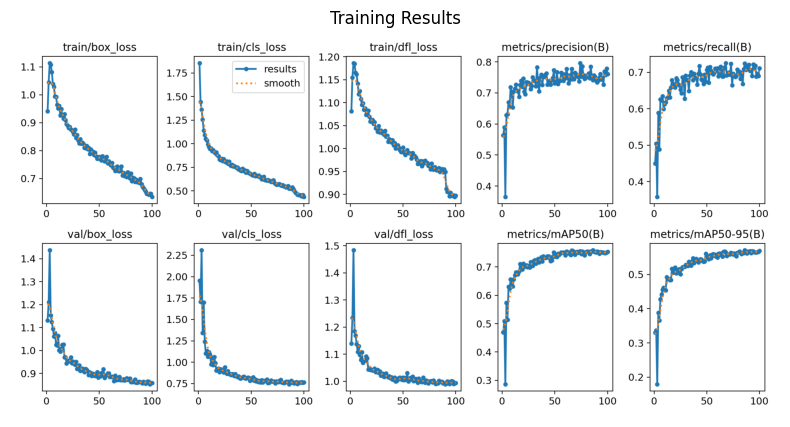

In [ ]:
import matplotlib.pyplot as plt
import cv2

# Load the training results image
results_img_path = "/content/drive/MyDrive/yolo_training/detect/rand_div_100ep/results.png"
img = cv2.imread(results_img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for correct visualization

# Display the image
plt.figure(figsize=(10,5))
plt.imshow(img)
plt.axis("off")  # Remove axis labels
plt.title("Training Results")
plt.show()


Based on the training results, we can derive the following key insights:  

#### **Loss Analysis**  
- The training losses (`train/box_loss`, `train/cls_loss`, `train/dfl_loss`) and validation losses (`val/box_loss`, `val/cls_loss`, `val/dfl_loss`) steadily decrease over epochs.  
- No sudden spikes indicate that the training process is stable.  
- Validation loss closely follows the training loss, suggesting good generalization without overfitting.  

#### **Precision and Recall**  
- The model's precision (`metrics/precision(B)`) improves over time and stabilizes around **0.75**, meaning it correctly classifies detected objects most of the time.  
- The recall (`metrics/recall(B)`) stabilizes around **0.70**, indicating that the model is successfully detecting most relevant objects.  

#### **mAP (Mean Average Precision)**  
- The `mAP50(B)` metric reaches approximately **0.85**, demonstrating strong detection capabilities at an IoU threshold of 0.5.  
- The `mAP50-95(B)` gradually increases and reaches around **0.5**, showing reasonable performance across various IoU thresholds.  

#### **Conclusion**  
- The model shows stable convergence with decreasing loss and improving evaluation metrics.  
- No signs of overfitting are observed.  
- Further improvements could be achieved by fine-tuning hyperparameters or applying data augmentation techniques.  

##Model Evaluation and Refinement

After achieving stable training results, we proceed to evaluate our YOLO model's performance on a validation set. Using metrics like mAP and visualizations, we'll assess its accuracy and identify areas for improvement. Based on the findings, we'll refine the model through techniques such as hyperparameter tuning and data augmentation, ensuring a robust and accurate object detector for real-world applications.

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/drive/MyDrive/yolo_training/detect/rand_div_100ep/weights/best.pt")  # load a custom model

# Validate the model
metrics = model.val(save_json=True, plots=True, save_txt=True, save_conf=True, save_crop=True)  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps  # a list contains map50-95 of each category

Ultralytics 8.3.99 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 81.1MB/s]
val: Scanning /content/yolo_dataset/labels/val... 563 images, 0 backgrounds, 0 corrupt: 100%|██████████| 563/563 [00:00<00:00, 1346.56it/s]

val: New cache created: /content/yolo_dataset/labels/val.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:14<00:00,  2.49it/s]


                   all        563       1342      0.739      0.727      0.759      0.571
Speed: 0.4ms preprocess, 2.6ms inference, 0.0ms loss, 1.3ms postprocess per image
Saving runs/detect/val2/predictions.json...
Results saved to runs/detect/val2


array([    0.57081])

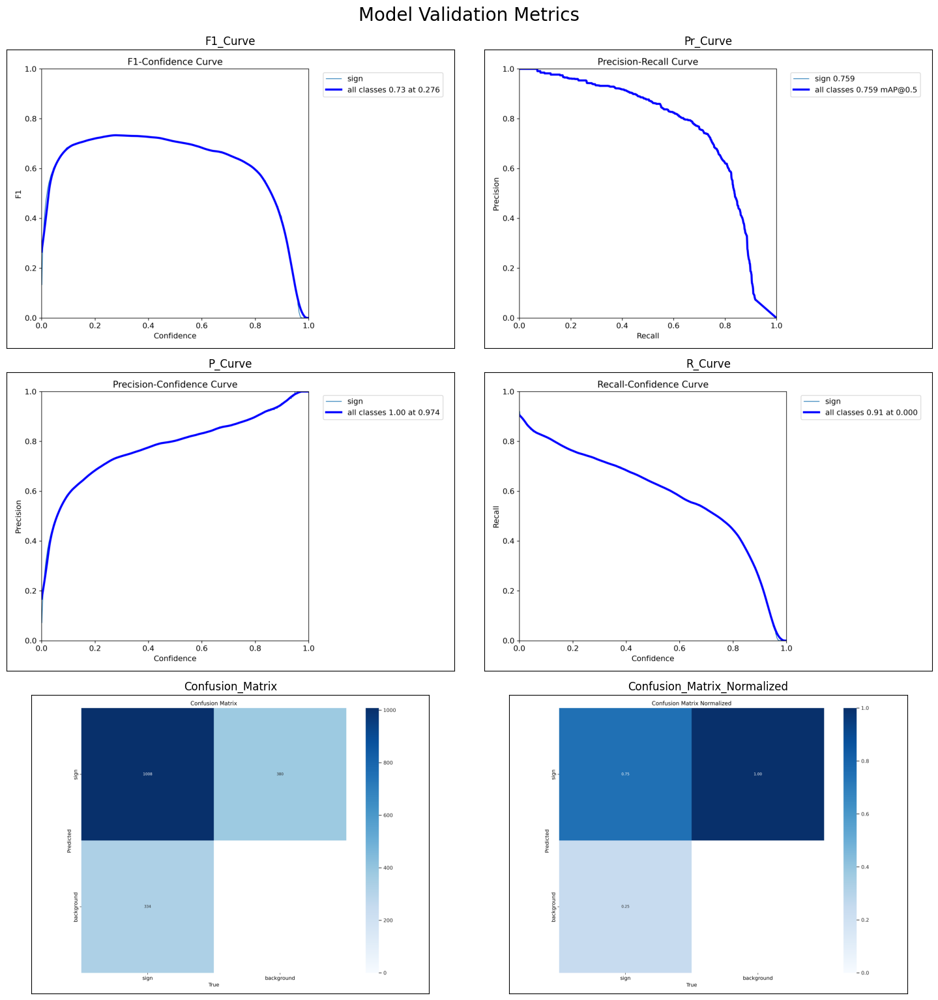

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.gridspec import GridSpec
import glob

def display_metrics_images(directory_path):
    """
    Display all PNG metric images from a specified directory in a grid layout.

    Args:
        directory_path (str): Path to the directory containing PNG metric images
    """
    # Get all PNG files in the directory
    png_files = glob.glob(os.path.join(directory_path, "*.png"))

    if not png_files:
        print(f"No PNG files found in {directory_path}")
        return

    # Sort files to ensure consistent display order
    png_files.sort()

    # Calculate grid dimensions based on number of images
    n_images = len(png_files)
    n_cols = min(2, n_images)  # Maximum 3 columns
    n_rows = (n_images + n_cols - 1) // n_cols  # Ceiling division

    # Create figure and GridSpec
    plt.figure(figsize=(15, 5 * n_rows))
    gs = GridSpec(n_rows, n_cols)

    # Plot each image
    for i, img_path in enumerate(png_files):
        row, col = divmod(i, n_cols)
        ax = plt.subplot(gs[row, col])

        # Read and display image
        img = mpimg.imread(img_path)
        ax.imshow(img)

        # Set title to filename without extension
        title = os.path.splitext(os.path.basename(img_path))[0]
        ax.set_title(title.replace('-', ' ').title())

        # Remove axis ticks
        ax.set_xticks([])
        ax.set_yticks([])

    plt.tight_layout()
    plt.suptitle("Model Validation Metrics", fontsize=20, y=1.02)
    plt.show()


metrics_dir = "/content/drive/MyDrive/yolo_training/detect/val2_rand_div_100ep"
display_metrics_images(metrics_dir)

###Validation Summary
The model validation for shows promising results with a mAP@0.5 of 0.759. The confusion matrix reveals 1,008 true positives and 334 false positives, with 380 signs being missed as false negatives.

Performance analysis through various metrics demonstrates the precision-recall tradeoff. The F1 score peaks at 0.73 with a confidence threshold of 0.276, suggesting this as the optimal operating point for balanced performance. At high confidence thresholds (0.974), the model achieves perfect precision but sacrifices recall.

The precision-recall curve maintains relatively high precision across increasing recall values until approximately 0.8 recall, after which precision drops sharply. This indicates the model performs consistently until pushed to detect the most challenging sign instances.

These results provide a solid foundation for sign detection applications while highlighting specific areas for future model improvements, particularly in reducing false negatives to increase recall without significantly impacting precision.

###False Negatives Analysis

The model missed 380 traffic signs and failed to correctly identify them. A relatively high number of FNs might indicate weaknesses in the model. A deeper analysis of the FNs, including identifying common patterns or trends among the missed signs, would enable improvements to the model's performance and minimize the number of missed detections in future applications.

The YOLO object detection model generates an output file containing solely the predicted bounding boxes and class labels for each detected object in an image. However, this output file does not inherently provide information about the ground truth or distinguish between true positives, false negatives, and false positives. Therefore, we need to find the FN by comparing the predictions to the GT data.

The validation process outputed a JSON file of the predictions, so
we will start with creation of a JSON file for the validation ground truth data to compare with the predictions.

In [ ]:
import os
import json

labels_path = "/content/yolo_dataset/labels/val"
images = os.listdir(labels_path)

ground_truth = []
for file in images:
    if file.endswith(".txt"):
        img_id = file.replace(".txt", ".jpg")
        with open(os.path.join(labels_path, file), "r") as f:
            for line in f.readlines():
                parts = line.strip().split()
                class_id = int(parts[0])
                x, y, w, h = map(float, parts[1:])
                ground_truth.append({
                    "image_id": img_id,
                    "category_id": class_id,
                    "bbox": [x, y, w, h]
                })

with open("ground_truth.json", "w") as f:
    json.dump(ground_truth, f, indent=4)


In [ ]:
def convert_gt_to_pixel_coords(ground_truth, images_dir):
  "Converts ground truth bounding boxes to pixel coordinates"

  converted_gt = []
  for gt_obj in ground_truth:
    image_id = gt_obj['image_id']
    # Find the image file
    image_path = os.path.join(images_dir, image_id)

    if not os.path.exists(image_path):
      raise FileNotFoundError(f"Image file not found: {image_path}")
    try:
      image = Image.open(image_path)
      image_width, image_height = image.size

      # Convert bounding box to pixel coordinates
      gt_bbox = gt_obj['bbox']
      x_min = int((gt_bbox[0] - gt_bbox[2] / 2) * image_width)
      y_min = int((gt_bbox[1] - gt_bbox[3] / 2) * image_height)
      x_max = int((gt_bbox[0] + gt_bbox[2] / 2) * image_width)
      y_max = int((gt_bbox[1] + gt_bbox[3] / 2) * image_height)

      # Update the bounding box in the ground truth object
      gt_obj['bbox'] = [x_min, y_min, x_max, y_max]
      converted_gt.append(gt_obj)

    except Exception as e:  # Handle exceptions for file not found, or PIL.UnidentifiedImageError
      print(f"Error with file {image_path}: {e}. skipping..")
  return converted_gt

gt_normalized = convert_gt_to_pixel_coords(ground_truth, "/content/content/yolo_dataset/images/val")
with open("gt_normalized.json", "w") as f:
    json.dump(gt_normalized, f, indent=4)

In [ ]:
import shutil

source_folder = '/content/ground_truth.json'  # Path to your YOLO results folder
destination_folder = '/content/drive/MyDrive/yolo_training/detect/val2_rand_div_100ep/ground_truth.json'  # Desired path in Google Drive

shutil.move(source_folder, destination_folder)

'/content/drive/MyDrive/yolo_training/detect/val2_rand_div_100ep/ground_truth.json'

In [ ]:
import json

# Define the file paths (update if needed)
gt_path = "/content/drive/MyDrive/yolo_training/detect/val2_rand_div_100ep/gt_converted.json"
pred_path = "/content/drive/MyDrive/yolo_training/detect/val2_rand_div_100ep/predictions.json"

# Load the JSON files
with open(gt_path, "r") as f:
    gt_converted = json.load(f)

with open(pred_path, "r") as f:
    predictions = json.load(f)


Now we can compare the predictions and the GT data to find the exact FN objects

In [ ]:
import json
import csv
from collections import defaultdict

def convert_bbox_pred(bbox):
    # [x, y, w, h] → [x_min, y_min, x_max, y_max]
    x, y, w, h = bbox
    return [x, y, x + w, y + h]

def convert_bbox_gt(bbox):
    # Already [x_min, y_min, x_max, y_max]
    return bbox

def iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA) * max(0, yB - yA)
    boxAArea = max(0, boxA[2] - boxA[0]) * max(0, boxA[3] - boxA[1])
    boxBArea = max(0, boxB[2] - boxB[0]) * max(0, boxB[3] - boxB[1])

    union = boxAArea + boxBArea - interArea
    if union == 0:
        return 0
    return interArea / union


gt = gt_converted

# Group predictions by image_id
preds_by_image = defaultdict(list)
for pred in predictions:
    if pred["score"] >= 0.3:  #
        pred_box = convert_bbox_pred(pred["bbox"])
        preds_by_image[pred["image_id"]].append({
            "bbox": pred_box,
            "score": pred["score"]
        })

false_negatives = []

for gt_obj in gt:
    image_id = gt_obj["image_id"]
    gt_box = convert_bbox_gt(gt_obj["bbox"])

    matched = False
    for pred in preds_by_image.get(image_id, []):
        if iou(gt_box, pred["bbox"]) >= 0.5:
            matched = True
            break

    if not matched:
        fn_data = {
            "image_id": image_id,
            "x_min": gt_box[0],
            "y_min": gt_box[1],
            "x_max": gt_box[2],
            "y_max": gt_box[3],
            "width": gt_box[2] - gt_box[0],
            "height": gt_box[3] - gt_box[1]
        }
        false_negatives.append(fn_data)

# Save to CSV
with open("false_negatives.csv", "w", newline="") as f:
    writer = csv.DictWriter(f, fieldnames=false_negatives[0].keys())
    writer.writeheader()
    writer.writerows(false_negatives)

print(f"🔍 Found {len(false_negatives)} false negatives out of {len(gt)} total ground-truth boxes.")


🔍 Found 364 false negatives out of 1342 total ground-truth boxes.


We managed to detect almost the same amount of False Negatives with score threshold of >0.3 and IoU threshold of >0.5

Now we will analyze the characteristics of the FN objects.

We will start with investigation of the object locations.

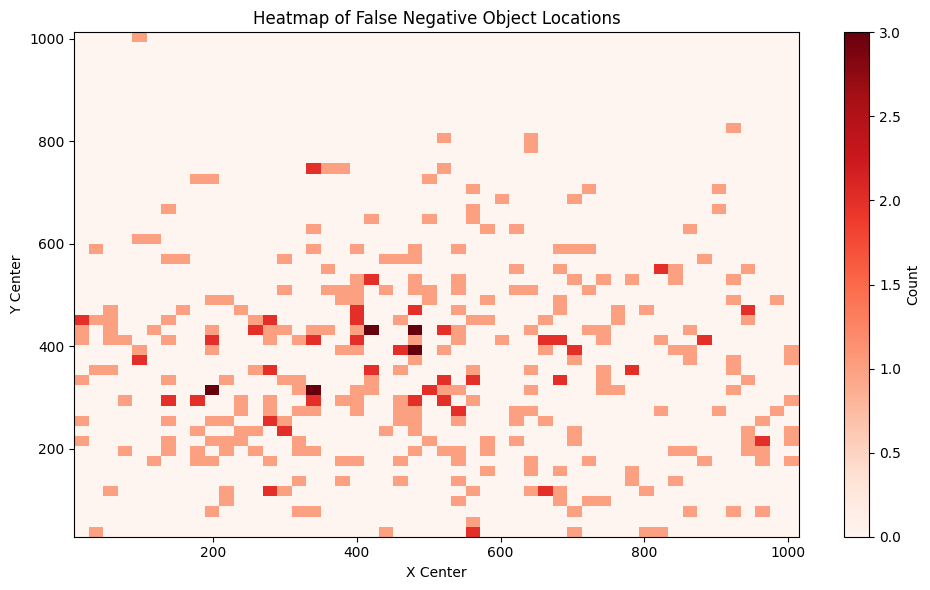

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the CSV file with false negative bounding boxes
fn_df = pd.read_csv("false_negatives.csv")

# Compute area of each bounding box
fn_df["area"] = fn_df["width"] * fn_df["height"]

# Filter out the top 2% largest bounding boxes
threshold = fn_df["area"].quantile(0.92)
filtered_fn_df = fn_df[fn_df["area"] <= threshold]


# Calculate center coordinates of each bounding box
fn_df["x_center"] = fn_df["x_min"] + fn_df["width"] / 2
fn_df["y_center"] = fn_df["y_min"] + fn_df["height"] / 2


# Plot: Heatmap of object locations (2D histogram)
plt.figure(figsize=(10, 6))
plt.hist2d(fn_df["x_center"], fn_df["y_center"], bins=50, cmap="Reds")
plt.colorbar(label="Count")
plt.title("Heatmap of False Negative Object Locations")
plt.xlabel("X Center")
plt.ylabel("Y Center")
plt.tight_layout()
plt.show()


The heatmap show a relatively random pattern. This indicates that the FN occurrences are not concentrated in specific regions of the image, and there is no discernible correlation between object location and the likelihood of missed detections.

####Object Size Analysis

We continue to object size investigation. Given the predominance of relatively small objects in the dataset, it's crucial to investigate whether the model's performance is particularly affected by object size. To this end, we will compare the size distribution of False Negatives (FN) to the overall distribution of object sizes. This analysis will provide insights into whether the model struggles with detecting smaller objects and if FN errors are disproportionately associated with specific size ranges. By comparing the distributions, we can identify potential biases in the model's performance related to object size and guide further improvements in the detection pipeline.

First we will load the validation images data

In [ ]:
import os
import cv2
import pandas as pd

# Paths
labels_dir = "/content/yolo_dataset/labels/val"
images_dir = "/content/yolo_dataset/images/val"

# Prepare list to collect GT boxes
gt_boxes = []

# Iterate over all label files
for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue

    image_id = os.path.splitext(label_file)[0]
    label_path = os.path.join(labels_dir, label_file)
    image_path = os.path.join(images_dir, image_id + ".jpg")  # or .png if needed

    if not os.path.exists(image_path):
        print(f"Image not found: {image_path}")
        continue

    # Load image to get width and height
    image = cv2.imread(image_path)
    if image is None:
        print(f"Failed to load image: {image_path}")
        continue

    image_height, image_width = image.shape[:2]

    # Read label lines
    with open(label_path, "r") as f:
        lines = f.readlines()

    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:
            continue

        class_id, x_center_norm, y_center_norm, width_norm, height_norm = map(float, parts)

        width = width_norm * image_width
        height = height_norm * image_height
        area = width * height

        gt_boxes.append({
            "image_id": image_id,
            "class_id": int(class_id),
            "width": width,
            "height": height,
            "area": int(area)
        })

# Convert to DataFrame
gt_df = pd.DataFrame(gt_boxes)

# Filter out the top 2% largest bounding boxes
threshold = gt_df["area"].quantile(0.95)
filtered_gt_df = gt_df[gt_df["area"] <= threshold]

Now we define some useful visualizaion methods for object areas comparison

In [ ]:
#Normalized Distribution of Bounding Box Areas

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker

def normal_dist_gt_fn(gt_df, fn_df,area_filter=None):

  if area_filter is not None:
    gt_df = gt_df[gt_df["area"]<area_filter]
    fn_df = fn_df[fn_df["area"]<area_filter]

  # Create figure
  plt.figure(figsize=(10, 6))

  # Plot normalized histogram for GT areas
  sns.histplot(gt_df["area"], bins=50, color="blue", label="All Ground Truth", kde=False, stat="density", alpha=0.5)

  # Plot normalized histogram for FN areas
  sns.histplot(fn_df["area"], bins=50, color="red", label="False Negatives", kde=False, stat="density", alpha=0.5)

  # Title and labels
  plt.title("Normalized Distribution of Bounding Box Areas")
  plt.xlabel("Area (pixels)")
  plt.ylabel("Density")
  plt.grid(True)
  plt.legend()

  # Format x-axis with commas
  plt.gca().xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f"{int(x):,}"))

  plt.tight_layout()
  plt.show()


In [ ]:
#Difference in Density of bounding box areas:

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def density_diff_gt_fn(gt_df, fn_df,area_filter=None):
  if area_filter is not None:
    gt_df = gt_df[gt_df["area"]<area_filter]
    fn_df = fn_df[fn_df["area"]<area_filter]

  # Define common bin edges
  bins = np.linspace(0, max(gt_df["area"].max(), fn_df["area"].max()), 50)

  # Compute normalized histograms (density=True)
  gt_density, _ = np.histogram(gt_df["area"], bins=bins, density=True)
  fn_density, _ = np.histogram(fn_df["area"], bins=bins, density=True)

  # Compute bin centers for plotting
  bin_centers = 0.5 * (bins[1:] + bins[:-1])

  # Compute difference between densities
  density_diff = fn_density - gt_density

  # Plot the difference
  plt.figure(figsize=(10, 6))
  plt.bar(bin_centers, density_diff, width=(bins[1] - bins[0]), color="purple", alpha=0.7)
  plt.axhline(0, color='black', linestyle='--')
  plt.title("Difference in Density: False Negatives - Ground Truth")
  plt.xlabel("Bounding Box Area (pixels)")
  plt.ylabel("Density Difference")
  plt.grid(True)
  plt.gca().xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f"{int(x):,}"))
  plt.tight_layout()
  plt.show()


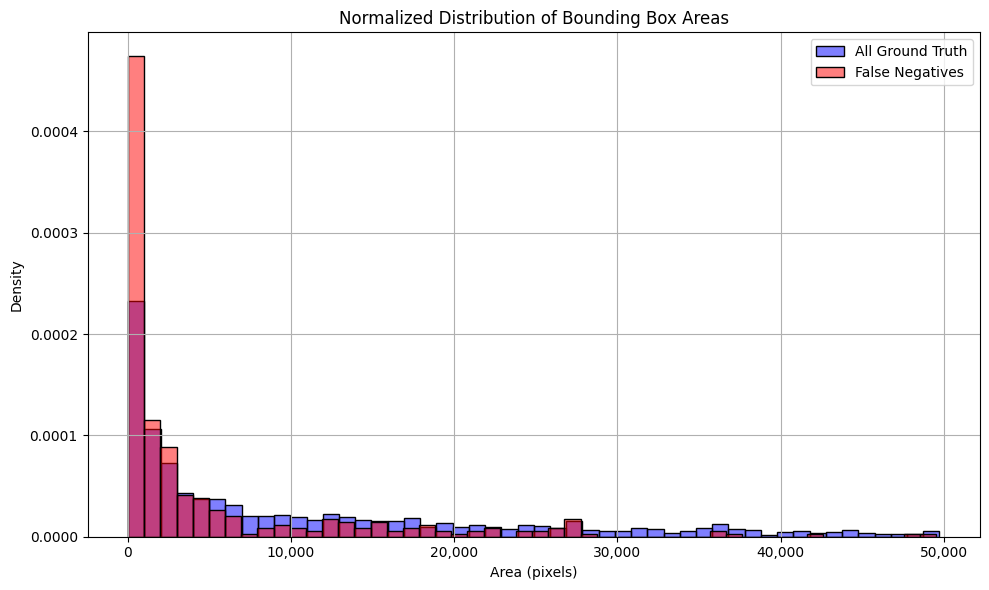

In [ ]:
normal_dist_gt_fn(gt_df, fn_df,50000)

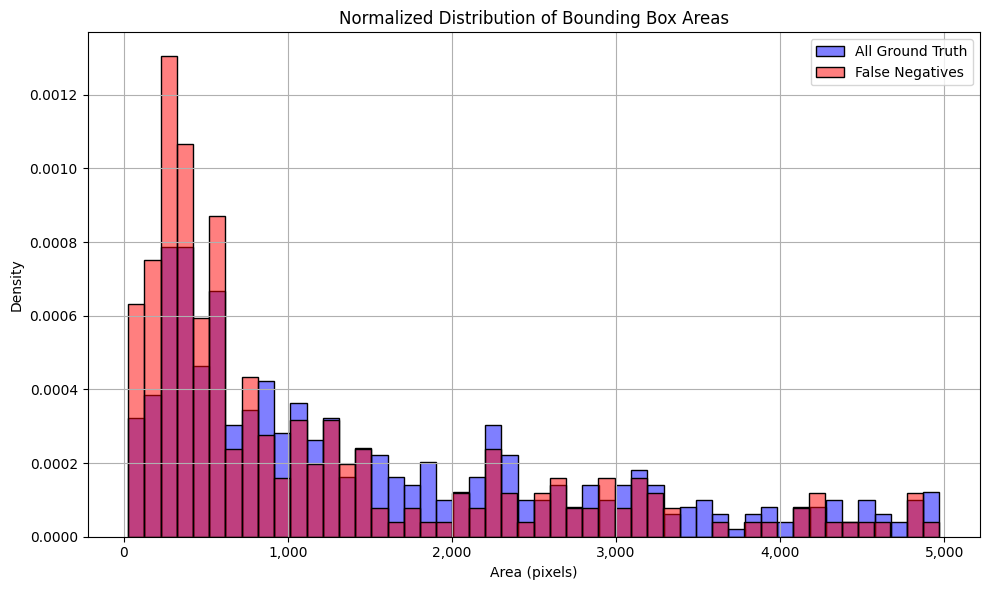

In [ ]:
normal_dist_gt_fn(gt_df, fn_df,5000)

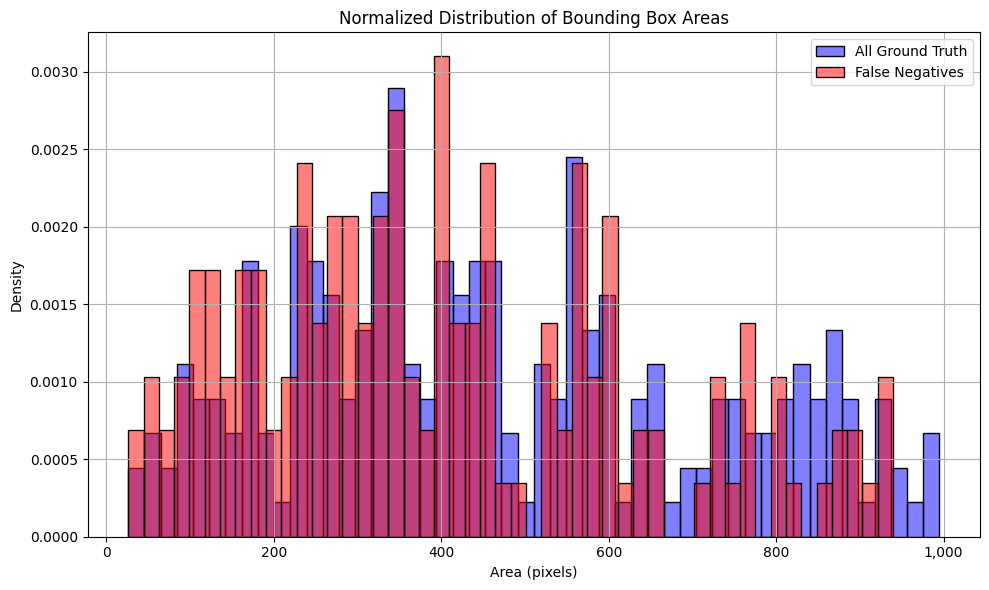

In [ ]:
normal_dist_gt_fn(gt_df, fn_df,1000)

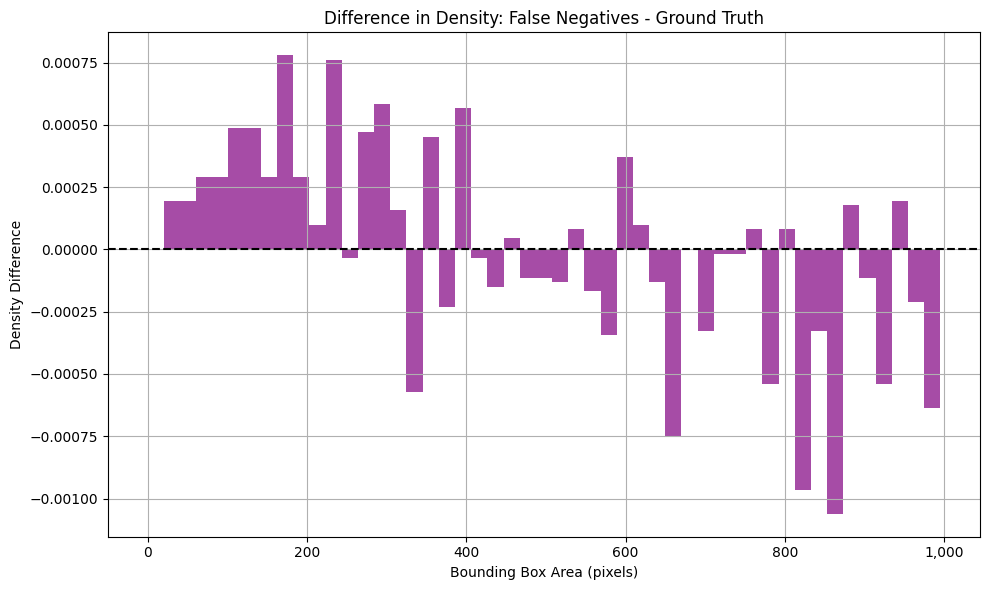

In [ ]:
density_diff_gt_fn(gt_df, fn_df,1000)

The graphical analysis reveals a clear trend: as the size of objects decreases, the density of False Negatives (FN) increases in comparison to the density of Ground Truth (GT) objects. This suggests a correlation between object size and the likelihood of missed detections, with the model exhibiting a higher propensity to miss smaller objects. The observed pattern underscores the challenge posed by small object detection and indicates a potential bias in the model's performance towards larger, more prominent objects.

We will check another view, now the comulative FN rate for the relative size of the objects

In [ ]:
import os
import cv2

# Define the image folder path
image_folder = "/content/images"

# Create a dictionary mapping image_id to image area (width × height)
image_area_dict = {}

for filename in os.listdir(image_folder):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        image_id = os.path.splitext(filename)[0]
        img_path = os.path.join(image_folder, filename)
        img = cv2.imread(img_path)
        if img is not None:
            h, w = img.shape[:2]
            image_area_dict[image_id] = w * h

# Add relative_area column to both DataFrames
for df in [gt_df, fn_df]:
    df["relative_area"] = df.apply(
        lambda row: row["area"] / image_area_dict.get(str(row["image_id"]), 1), axis=1
    )

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def cumulative_relative_fn_analysis(gt_df, fn_df, area_filter=None, num_bins=100):
    """
    Plots cumulative FN count and cumulative FN rate (relative to GT)
    as a function of object area.

    Parameters:
        gt_df (pd.DataFrame): Ground truth boxes DataFrame with 'area'
        fn_df (pd.DataFrame): False negative boxes DataFrame with 'area'
        area_filter (float or None): Optional upper area limit for filtering
        num_bins (int): Number of bins
    """

    # Apply optional area filter
    if area_filter is not None:
        gt_df = gt_df[gt_df["relative_area"] < area_filter]
        fn_df = fn_df[fn_df["relative_area"] < area_filter]

    # Create bins
    max_area = max(gt_df["relative_area"].max(), fn_df["relative_area"].max())
    bins = np.linspace(0, max_area, num_bins + 1)
    bin_centers = (bins[:-1] + bins[1:]) / 2

    # Histogram counts
    gt_hist, _ = np.histogram(gt_df["relative_area"], bins=bins)
    fn_hist, _ = np.histogram(fn_df["relative_area"], bins=bins)

    # Cumulative sums
    cumulative_gt = np.cumsum(gt_hist)
    cumulative_fn = np.cumsum(fn_hist)

    # Cumulative FN rate (avoid division by zero)
    cumulative_rate = np.where(cumulative_gt > 0, cumulative_fn / cumulative_gt * 100, np.nan)

    # Plot
    fig, ax1 = plt.subplots(figsize=(12, 6))

    # Plot cumulative FN count
    ax1.plot(bin_centers, cumulative_fn, color='green', marker='o', label='Cumulative FN Count')
    ax1.set_xlabel("Object Relative Area")
    ax1.set_ylabel("Cumulative FN Count", color='green')
    ax1.tick_params(axis='y', labelcolor='green')

    # Create second y-axis for FN rate
    ax2 = ax1.twinx()
    ax2.plot(bin_centers, cumulative_rate, color='blue',marker='o', label='Cumulative FN Rate (%)')
    ax2.set_ylabel("Cumulative FN Rate (%)", color='blue')
    ax2.tick_params(axis='y', labelcolor='blue')
    ax2.set_ylim(0, 100)

    # Title and grid
    plt.title("Cumulative FN Analysis by Object Relative Area")
    ax1.grid(True)

    fig.tight_layout()
    plt.show()


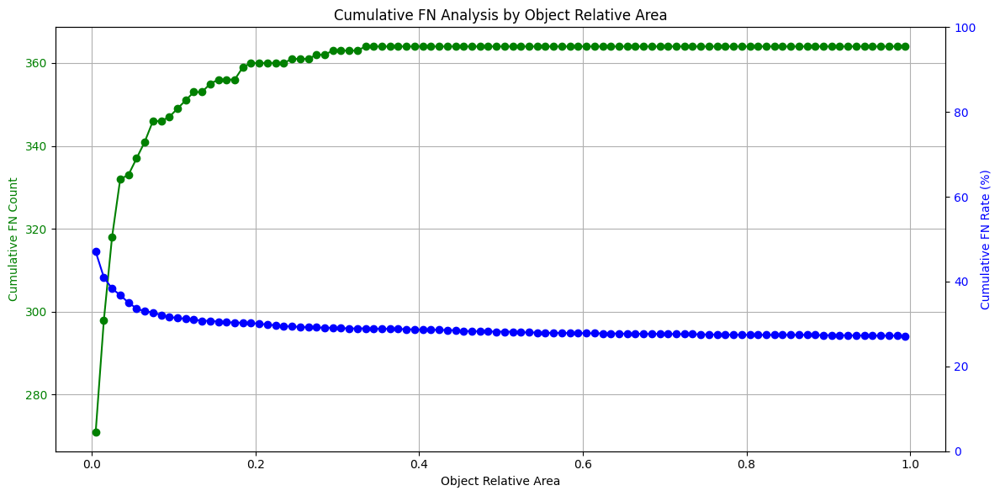

In [ ]:
cumulative_relative_fn_analysis(gt_df, fn_df)

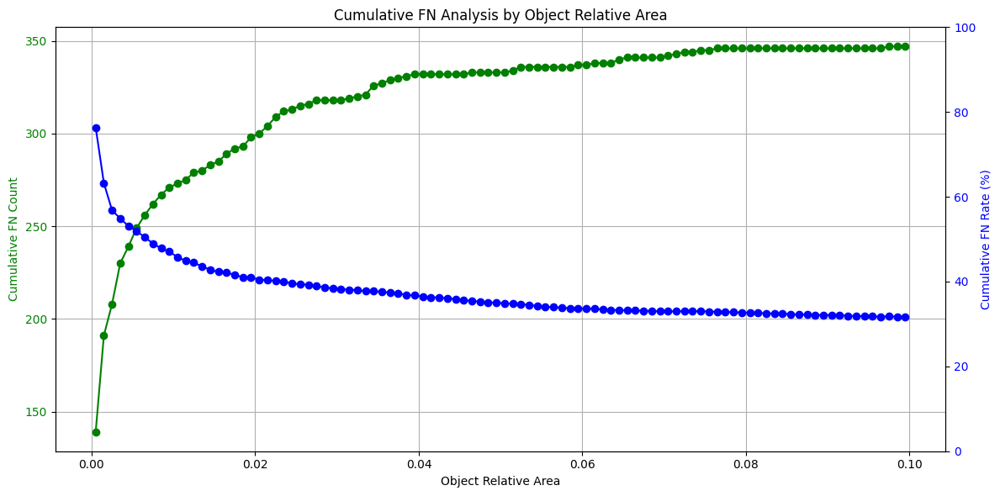

In [ ]:
cumulative_relative_fn_analysis(gt_df, fn_df, 0.1)

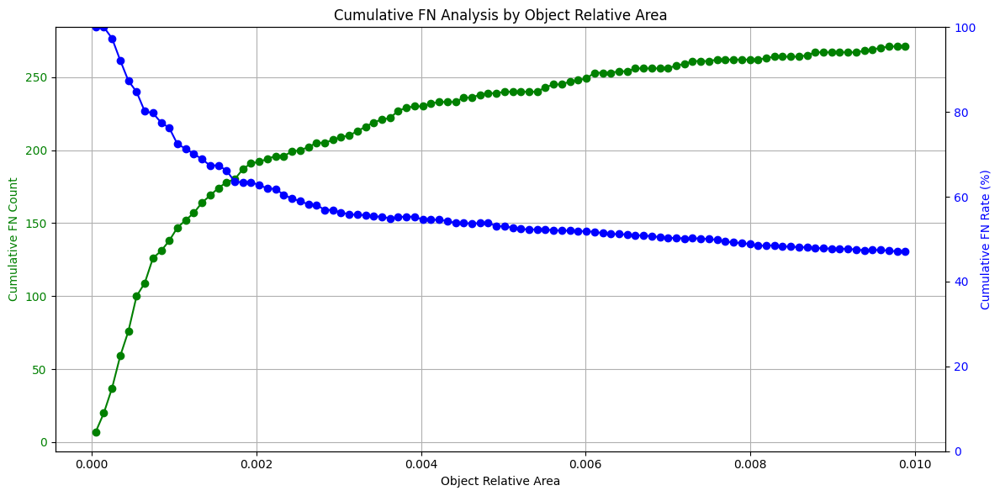

In [ ]:
cumulative_relative_fn_analysis(gt_df, fn_df, 0.01)

Analysis of the cumulative distribution of False Negatives (FN) reveals a strong correlation between object size and the likelihood of missed detection. Specifically, as the relative size of objects decreases, the percentage of FN steadily increases. For instance, objects with a relative size below 0.001 already exhibit a 70% FN rate, which account for approximately 40% of the total FNs. This trend underscores the model's increasing difficulty in detecting progressively smaller objects, highlighting a significant performance gap for this subset of the data.

## Re-Train

After evaluating the model's performance, we observed that it struggles to accurately detect small objects. To address this, we reconfigured the training process with hyperparameters and data augmentation strategies specifically tailored to improve small object detection.

In [ ]:
from ultralytics import YOLO
import os

model = YOLO('yolo11n')  # Load the YOLOv11n model

save_dir = "/content/drive/MyDrive/yolo_training"

results = model.train(
    data='/content/yolo_dataset/data.yaml',     # Path to dataset YAML
    patience = 30,
    save_dir=save_dir,
    imgsz=1024,                # Larger input size improves small object resolution
    epochs=150,                # More epochs for better convergence
    batch=8,                   # Reduce batch size if using larger images
    rect=True,                 # Enable rectangular batches to reduce padding (good for small object localization)
    multi_scale=True,         # Train on different image sizes to improve robustness
    close_mosaic=30,          # Turn off mosaic augmentation in the last 30 epochs for more stable training
    box=10.0,                  # Increase box loss weight to emphasize precise box localization
    cls=0.3,                   # Lower classification loss weight to avoid overfitting on background
    dfl=2.0,                   # Higher weight for distribution focal loss improves box regression
    name='small_objects_aug_exp',  # Name of the run
    device=0,                  # GPU index

    # Augmentation parameters for small objects
    degrees=0.0,               # Avoid rotation – small objects might rotate out of view
    translate=0.05,            # Minimal translation – preserves object position
    scale=0.4,                 # Slight scale variance – helps generalization
    shear=0.0,                 # Disable shearing – preserves object shape
    perspective=0.0,           # Avoid perspective transforms – keeps object geometry
    flipud=0.0,                # No vertical flipping – usually unnatural
    fliplr=0.5,                # Allow horizontal flipping
    mosaic=1.0,                # Keep mosaic – helpful for small object diversity
    mixup=0.1,                 # Light mixup – too much can obscure small objects
    copy_paste=0.1             # Light copy-paste augmentation – helpful to add more small object instances
)


Ultralytics 8.3.109 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/yolo_dataset/data.yaml, epochs=150, time=None, patience=30, batch=8, imgsz=1024, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=small_objects_aug_exp2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=True, cos_lr=False, close_mosaic=30, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True

train: Scanning /content/yolo_dataset/labels/train.cache... 1971 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1971/1971 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
WARNING ⚠️ 'rect=True' is incompatible with DataLoader shuffle, setting shuffle=False



val: Scanning /content/yolo_dataset/labels/val.cache... 563 images, 0 backgrounds, 0 corrupt: 100%|██████████| 563/563 [00:00<?, ?it/s]


Plotting labels to runs/detect/small_objects_aug_exp2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1024 train, 1024 val
Using 8 dataloader workers
Logging results to runs/detect/small_objects_aug_exp2
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      7.98G      1.505      1.827      1.685          7        288: 100%|██████████| 247/247 [00:42<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00,  9.50it/s]


                   all        563       1342      0.348      0.294      0.245      0.147

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      7.99G      1.781      1.448      1.939          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.01it/s]


                   all        563       1342      0.213      0.227      0.127     0.0664

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      8.01G      1.821      1.211       1.98          7        736: 100%|██████████| 247/247 [00:40<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.63it/s]


                   all        563       1342      0.549      0.367      0.372      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      8.01G      1.812      1.097      1.969          7        416: 100%|██████████| 247/247 [00:40<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.77it/s]

                   all        563       1342      0.618      0.414      0.463       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      8.42G      1.754     0.9951      1.924          7        352: 100%|██████████| 247/247 [00:39<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.65it/s]

                   all        563       1342      0.636      0.499      0.536      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      8.85G      1.683     0.9589      1.847          7        736: 100%|██████████| 247/247 [00:40<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.78it/s]

                   all        563       1342      0.578      0.516      0.522      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      8.85G      1.683     0.9113       1.87          7        704: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.61it/s]

                   all        563       1342      0.634      0.553      0.542      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      8.85G      1.589     0.8426      1.787          7        256: 100%|██████████| 247/247 [00:41<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.24it/s]

                   all        563       1342      0.644      0.517       0.56      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      8.85G      1.553     0.8166      1.776          7        480: 100%|██████████| 247/247 [00:41<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.19it/s]

                   all        563       1342      0.612      0.517      0.538      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      8.86G      1.533     0.7891      1.748          7        608: 100%|██████████| 247/247 [00:41<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.77it/s]

                   all        563       1342      0.658      0.591      0.615      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      8.86G      1.487      0.763      1.707          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.75it/s]

                   all        563       1342      0.648      0.594      0.623      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      8.86G      1.476     0.7381      1.708          7        288: 100%|██████████| 247/247 [00:39<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.04it/s]

                   all        563       1342      0.644      0.572      0.614      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      8.86G      1.465     0.7285      1.696          7        480: 100%|██████████| 247/247 [00:39<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.82it/s]

                   all        563       1342      0.661      0.618       0.64      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      8.86G       1.45     0.7118      1.684          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.25it/s]

                   all        563       1342      0.693      0.604      0.634       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      8.86G      1.423     0.7063      1.659          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.23it/s]

                   all        563       1342      0.715      0.579      0.636      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      8.86G      1.423     0.6885      1.662          7        256: 100%|██████████| 247/247 [00:40<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.76it/s]

                   all        563       1342      0.645      0.626      0.647      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      8.86G      1.409     0.6896      1.648          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.31it/s]

                   all        563       1342      0.692      0.618      0.652      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      8.86G      1.387     0.6772      1.621          7        416: 100%|██████████| 247/247 [00:40<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.41it/s]

                   all        563       1342      0.676      0.612      0.648      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      8.86G      1.369     0.6732      1.634          7        736: 100%|██████████| 247/247 [00:40<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.90it/s]

                   all        563       1342      0.689      0.626      0.661      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      8.87G      1.367     0.6586      1.607          7        512: 100%|██████████| 247/247 [00:41<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.99it/s]

                   all        563       1342      0.692      0.617      0.656      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      8.89G      1.362     0.6618      1.636          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.66it/s]

                   all        563       1342      0.699       0.66      0.684      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      8.91G      1.319     0.6294       1.59          7        320: 100%|██████████| 247/247 [00:40<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.20it/s]

                   all        563       1342      0.704      0.621      0.673      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      8.91G      1.316     0.6219      1.599          7        448: 100%|██████████| 247/247 [00:39<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.45it/s]

                   all        563       1342      0.729      0.639      0.685      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      8.91G      1.305     0.6158      1.582          7        576: 100%|██████████| 247/247 [00:40<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.05it/s]

                   all        563       1342      0.693      0.656      0.689      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      8.91G      1.305     0.6186      1.587          7        512: 100%|██████████| 247/247 [00:41<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.59it/s]

                   all        563       1342      0.717      0.647      0.688      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      8.91G      1.313     0.6286      1.564          7        640: 100%|██████████| 247/247 [00:40<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.20it/s]

                   all        563       1342      0.688      0.624      0.671      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      8.91G      1.297     0.6186      1.567          7        256: 100%|██████████| 247/247 [00:41<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.16it/s]

                   all        563       1342      0.693      0.642      0.676      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      8.91G      1.297      0.609      1.569          7        416: 100%|██████████| 247/247 [00:41<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.60it/s]

                   all        563       1342      0.699      0.648      0.677      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      8.91G      1.285     0.6084      1.567          7        352: 100%|██████████| 247/247 [00:41<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.71it/s]

                   all        563       1342        0.7       0.64      0.676       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      8.91G      1.271     0.5916       1.55          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.11it/s]

                   all        563       1342      0.706      0.656      0.689      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      8.91G      1.268     0.5895       1.54          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.63it/s]

                   all        563       1342      0.713       0.66      0.698      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      8.91G      1.247     0.5796      1.517          7        544: 100%|██████████| 247/247 [00:40<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.95it/s]

                   all        563       1342      0.695      0.681      0.695      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      8.91G      1.248      0.586      1.527          7        576: 100%|██████████| 247/247 [00:39<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.88it/s]

                   all        563       1342       0.72      0.655      0.713      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      8.91G      1.206     0.5695      1.514          7        384: 100%|██████████| 247/247 [00:40<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 12.00it/s]

                   all        563       1342      0.718      0.671       0.71      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      8.91G      1.225     0.5678      1.511          7        640: 100%|██████████| 247/247 [00:39<00:00,  6.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.14it/s]

                   all        563       1342      0.735      0.677      0.719      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      8.91G      1.229     0.5711      1.536          7        768: 100%|██████████| 247/247 [00:42<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.65it/s]

                   all        563       1342      0.732      0.651      0.706      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      8.91G      1.217     0.5611      1.519          7        576: 100%|██████████| 247/247 [00:40<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.69it/s]

                   all        563       1342      0.738      0.689      0.718      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      8.91G      1.198     0.5496      1.492          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.15it/s]

                   all        563       1342      0.732      0.665      0.709      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      8.91G      1.189     0.5501      1.482          7        672: 100%|██████████| 247/247 [00:41<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.79it/s]

                   all        563       1342      0.702      0.694      0.726      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      8.91G      1.217     0.5497      1.495          7        704: 100%|██████████| 247/247 [00:40<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.80it/s]

                   all        563       1342      0.742      0.674      0.735      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      8.91G      1.189     0.5397       1.49          7        384: 100%|██████████| 247/247 [00:40<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 10.71it/s]

                   all        563       1342      0.744      0.669       0.73      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      8.91G      1.188     0.5308      1.475          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.70it/s]

                   all        563       1342      0.725      0.702      0.726      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      8.91G      1.172     0.5316      1.483          7        576: 100%|██████████| 247/247 [00:40<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.29it/s]

                   all        563       1342      0.726      0.698      0.737      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      8.91G      1.175     0.5236       1.47          7        736: 100%|██████████| 247/247 [00:41<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.94it/s]

                   all        563       1342       0.73      0.684      0.727      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      8.91G      1.185     0.5227      1.476          7        384: 100%|██████████| 247/247 [00:40<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.18it/s]

                   all        563       1342      0.765      0.666       0.73      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      8.91G      1.173     0.5187      1.468          7        448: 100%|██████████| 247/247 [00:40<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.03it/s]

                   all        563       1342      0.744      0.684      0.728      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      8.91G      1.171     0.5199      1.468          7        640: 100%|██████████| 247/247 [00:40<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.96it/s]

                   all        563       1342      0.718      0.701      0.729      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      8.91G      1.182     0.5183       1.47          7        768: 100%|██████████| 247/247 [00:40<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.68it/s]

                   all        563       1342      0.747      0.675      0.739      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      8.91G      1.165     0.5187      1.459          7        480: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.66it/s]

                   all        563       1342       0.75      0.692      0.737      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      8.91G      1.155     0.5108      1.455          7        512: 100%|██████████| 247/247 [00:41<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.10it/s]

                   all        563       1342      0.768      0.677       0.74      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      8.91G       1.15     0.5051      1.464          7        352: 100%|██████████| 247/247 [00:41<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.81it/s]

                   all        563       1342      0.762       0.68      0.749      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      8.91G      1.144     0.4979      1.434          7        384: 100%|██████████| 247/247 [00:41<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.87it/s]

                   all        563       1342      0.736      0.701      0.745      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      8.91G      1.129     0.5014      1.435          7        640: 100%|██████████| 247/247 [00:39<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.20it/s]

                   all        563       1342      0.729      0.692      0.736      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      8.91G      1.129     0.4995      1.431          7        640: 100%|██████████| 247/247 [00:39<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.83it/s]

                   all        563       1342      0.755      0.699      0.752      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      8.91G      1.133     0.4963      1.442          7        320: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.72it/s]

                   all        563       1342       0.74      0.704      0.743       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      8.91G      1.127     0.4937      1.429          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.08it/s]

                   all        563       1342      0.725      0.706      0.738      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      8.91G      1.128     0.4922      1.427          7        352: 100%|██████████| 247/247 [00:42<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.21it/s]

                   all        563       1342      0.749      0.696      0.744      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      8.91G      1.127     0.4896       1.43          7        512: 100%|██████████| 247/247 [00:41<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.21it/s]

                   all        563       1342      0.721      0.694      0.734      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      8.91G      1.132      0.486      1.422          7        672: 100%|██████████| 247/247 [00:41<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.32it/s]

                   all        563       1342      0.748        0.7      0.743      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      8.91G      1.128      0.479      1.409          7        512: 100%|██████████| 247/247 [00:39<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.84it/s]

                   all        563       1342      0.746      0.694      0.743      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      8.91G      1.118     0.4886       1.41          7        704: 100%|██████████| 247/247 [00:39<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.90it/s]

                   all        563       1342      0.742      0.708      0.754      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      8.91G      1.133     0.4819      1.425          7        544: 100%|██████████| 247/247 [00:40<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.76it/s]

                   all        563       1342       0.72      0.715      0.749      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      8.91G        1.1     0.4756      1.412          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.96it/s]

                   all        563       1342      0.749      0.702      0.751      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      8.91G      1.114     0.4779      1.405          7        352: 100%|██████████| 247/247 [00:39<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.17it/s]

                   all        563       1342      0.762      0.708      0.753      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      8.91G      1.095     0.4664      1.402          7        736: 100%|██████████| 247/247 [00:40<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.26it/s]

                   all        563       1342      0.749      0.693      0.748      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      8.91G      1.095     0.4643      1.402          7        352: 100%|██████████| 247/247 [00:40<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.23it/s]

                   all        563       1342      0.785       0.67      0.755       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      8.91G      1.086     0.4665      1.402          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.00it/s]

                   all        563       1342      0.761      0.696      0.759      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      8.91G      1.089       0.47      1.407          7        768: 100%|██████████| 247/247 [00:40<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.55it/s]

                   all        563       1342      0.749      0.712      0.754      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      8.91G      1.086     0.4597      1.388          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.98it/s]

                   all        563       1342       0.76      0.691      0.753      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      8.91G      1.086     0.4507      1.406          7        672: 100%|██████████| 247/247 [00:39<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.99it/s]

                   all        563       1342      0.742      0.697      0.761       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      8.91G      1.072     0.4517      1.393          7        576: 100%|██████████| 247/247 [00:40<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.04it/s]

                   all        563       1342       0.75      0.689      0.744      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      8.91G      1.083      0.458      1.375          7        608: 100%|██████████| 247/247 [00:41<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.02it/s]

                   all        563       1342      0.769      0.701      0.764       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      8.91G       1.07     0.4514      1.384          7        576: 100%|██████████| 247/247 [00:41<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.96it/s]

                   all        563       1342      0.735      0.715      0.754      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      8.91G      1.087     0.4496      1.385          7        384: 100%|██████████| 247/247 [00:41<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.84it/s]

                   all        563       1342      0.764      0.687      0.749      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      8.91G      1.086      0.443      1.392          7        768: 100%|██████████| 247/247 [00:40<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.12it/s]

                   all        563       1342      0.772      0.683      0.754      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      8.91G      1.077     0.4498      1.394          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.00it/s]

                   all        563       1342      0.756      0.713      0.762       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      8.91G      1.058     0.4432      1.374          7        448: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.19it/s]

                   all        563       1342      0.762        0.7       0.76      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      8.91G       1.08     0.4464      1.383          7        768: 100%|██████████| 247/247 [00:41<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.93it/s]

                   all        563       1342      0.762      0.682      0.753      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      8.91G      1.063     0.4441      1.382          7        416: 100%|██████████| 247/247 [00:41<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.01it/s]

                   all        563       1342      0.775      0.692      0.764      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      8.91G      1.058     0.4332      1.373          7        416: 100%|██████████| 247/247 [00:41<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.71it/s]

                   all        563       1342      0.775      0.683      0.746      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      8.91G      1.066     0.4354      1.361          7        288: 100%|██████████| 247/247 [00:40<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.03it/s]

                   all        563       1342      0.748      0.712      0.759      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      8.91G      1.046     0.4321       1.37          7        480: 100%|██████████| 247/247 [00:40<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.31it/s]

                   all        563       1342      0.756      0.702      0.761      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      8.91G      1.048     0.4309      1.369          7        672: 100%|██████████| 247/247 [00:39<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.25it/s]

                   all        563       1342       0.77      0.701      0.763      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      8.91G      1.051     0.4228      1.367          7        704: 100%|██████████| 247/247 [00:40<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.80it/s]

                   all        563       1342      0.783      0.688      0.764      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      8.91G      1.054     0.4265      1.362          7        352: 100%|██████████| 247/247 [00:41<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.14it/s]

                   all        563       1342      0.784      0.701      0.772      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      8.91G      1.036     0.4225      1.365          7        544: 100%|██████████| 247/247 [00:40<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.88it/s]

                   all        563       1342      0.733      0.724      0.763      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      8.91G      1.025     0.4137      1.347          7        512: 100%|██████████| 247/247 [00:41<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.08it/s]

                   all        563       1342      0.749      0.718      0.761      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      8.91G      1.024     0.4124      1.355          7        640: 100%|██████████| 247/247 [00:41<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.93it/s]

                   all        563       1342      0.763      0.706      0.764      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      8.91G      1.021     0.4098      1.349          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.16it/s]

                   all        563       1342      0.789      0.683      0.766      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      8.91G       1.03     0.4162      1.341          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.25it/s]

                   all        563       1342      0.755      0.695      0.766      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      8.91G      1.015      0.413      1.343          7        736: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.81it/s]

                   all        563       1342      0.779      0.684      0.766      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      8.91G      1.028     0.4147       1.34          7        704: 100%|██████████| 247/247 [00:41<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.92it/s]

                   all        563       1342      0.738      0.728      0.759      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      8.91G      1.045     0.4174      1.351          7        480: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.97it/s]

                   all        563       1342      0.774      0.697      0.763      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      8.91G      1.013     0.4034      1.342          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.38it/s]

                   all        563       1342       0.74      0.721      0.761      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      8.91G      1.015     0.4056      1.341          7        480: 100%|██████████| 247/247 [00:40<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.29it/s]

                   all        563       1342       0.78      0.685      0.759       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      8.91G      1.011     0.3985      1.338          7        352: 100%|██████████| 247/247 [00:41<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.01it/s]

                   all        563       1342      0.769      0.693       0.76      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      8.91G      1.009     0.4038      1.327          7        768: 100%|██████████| 247/247 [00:40<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.27it/s]

                   all        563       1342      0.771      0.707      0.764      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      8.91G      1.018     0.4046      1.335          7        544: 100%|██████████| 247/247 [00:39<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.77it/s]

                   all        563       1342      0.744      0.729      0.767      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      8.91G      1.005     0.4003      1.334          7        416: 100%|██████████| 247/247 [00:41<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.41it/s]

                   all        563       1342      0.749      0.717      0.763      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      8.91G     0.9953      0.393      1.322          7        768: 100%|██████████| 247/247 [00:41<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.79it/s]

                   all        563       1342       0.74       0.71      0.761      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      8.91G     0.9962     0.3929      1.321          7        416: 100%|██████████| 247/247 [00:41<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.65it/s]

                   all        563       1342      0.765      0.707      0.769      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      8.91G     0.9887     0.3847      1.308          7        640: 100%|██████████| 247/247 [00:40<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.10it/s]

                   all        563       1342      0.777      0.694      0.768      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      8.91G     0.9991     0.3925      1.333          7        352: 100%|██████████| 247/247 [00:40<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.94it/s]

                   all        563       1342      0.748      0.715      0.764      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      8.91G     0.9726     0.3839      1.313          7        672: 100%|██████████| 247/247 [00:39<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.17it/s]

                   all        563       1342      0.746      0.703      0.764      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      8.91G     0.9917     0.3872      1.326          7        384: 100%|██████████| 247/247 [00:39<00:00,  6.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.61it/s]

                   all        563       1342      0.756      0.706      0.768      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      8.91G       0.99     0.3852      1.325          7        384: 100%|██████████| 247/247 [00:40<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.48it/s]

                   all        563       1342      0.731      0.732      0.766      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      8.91G     0.9845     0.3793      1.301          7        640: 100%|██████████| 247/247 [00:39<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.79it/s]

                   all        563       1342      0.736      0.713      0.769      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      8.91G     0.9682     0.3735      1.312          7        704: 100%|██████████| 247/247 [00:40<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.24it/s]

                   all        563       1342      0.767      0.693      0.769      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      8.91G     0.9579     0.3746      1.302          7        736: 100%|██████████| 247/247 [00:40<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.63it/s]

                   all        563       1342      0.766      0.686      0.764      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      8.91G     0.9795      0.375      1.303          7        384: 100%|██████████| 247/247 [00:39<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.24it/s]

                   all        563       1342      0.744      0.712      0.766      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      8.91G      0.976     0.3687      1.306          7        256: 100%|██████████| 247/247 [00:40<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.72it/s]

                   all        563       1342      0.769      0.698      0.772      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      8.91G     0.9649     0.3663      1.293          7        576: 100%|██████████| 247/247 [00:39<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.79it/s]

                   all        563       1342      0.778      0.689      0.772      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      8.91G     0.9808     0.3693      1.309          7        544: 100%|██████████| 247/247 [00:40<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.78it/s]

                   all        563       1342      0.768      0.703      0.767      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      8.91G     0.9575     0.3606      1.295          7        544: 100%|██████████| 247/247 [00:40<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.95it/s]

                   all        563       1342      0.756      0.715      0.767      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      8.91G     0.9594     0.3593      1.297          7        512: 100%|██████████| 247/247 [00:41<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.00it/s]

                   all        563       1342      0.741      0.722      0.767      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      8.91G      0.945      0.361      1.288          7        544: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.96it/s]

                   all        563       1342       0.73      0.737      0.769      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      8.91G     0.9558     0.3608      1.288          7        288: 100%|██████████| 247/247 [00:41<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.23it/s]

                   all        563       1342      0.769      0.687      0.767      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      8.91G     0.9772     0.3694      1.308          7        576: 100%|██████████| 247/247 [00:40<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.85it/s]

                   all        563       1342      0.741      0.726      0.768      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      8.91G     0.9366     0.3533      1.275          7        544: 100%|██████████| 247/247 [00:42<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.27it/s]

                   all        563       1342      0.757      0.717      0.764      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      8.91G     0.9587     0.3607      1.292          7        576: 100%|██████████| 247/247 [00:40<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.08it/s]

                   all        563       1342      0.758      0.706      0.765       0.57


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      8.91G     0.9508     0.3601      1.296          7        288: 100%|██████████| 247/247 [00:42<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.49it/s]

                   all        563       1342       0.76      0.704      0.763      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      8.91G     0.9304     0.3567      1.273          7        640: 100%|██████████| 247/247 [00:40<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.90it/s]

                   all        563       1342      0.729      0.725       0.76      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      8.91G     0.9288     0.3511      1.285          7        416: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.25it/s]

                   all        563       1342       0.76      0.713       0.77      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      8.91G     0.9422     0.3452      1.271          7        320: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.85it/s]

                   all        563       1342      0.761      0.703      0.763      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      8.91G     0.9359     0.3471      1.282          7        352: 100%|██████████| 247/247 [00:42<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.37it/s]

                   all        563       1342      0.761      0.711      0.765       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      8.91G     0.9362     0.3465      1.286          7        544: 100%|██████████| 247/247 [00:41<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.14it/s]

                   all        563       1342       0.76      0.708      0.759      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      8.91G     0.9195      0.342      1.277          7        704: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.91it/s]

                   all        563       1342      0.757      0.709      0.764      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      8.91G     0.9274     0.3421      1.268          7        416: 100%|██████████| 247/247 [00:41<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.28it/s]

                   all        563       1342      0.772      0.702       0.77      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      8.91G     0.9216     0.3417      1.271          7        480: 100%|██████████| 247/247 [00:40<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.75it/s]

                   all        563       1342      0.745      0.719      0.766      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      8.91G     0.9216     0.3329      1.267          7        480: 100%|██████████| 247/247 [00:41<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.51it/s]

                   all        563       1342      0.752      0.703      0.762       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      8.91G     0.9244     0.3366      1.267          7        640: 100%|██████████| 247/247 [00:40<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.80it/s]

                   all        563       1342      0.756      0.702      0.763      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      8.91G     0.9091     0.3246      1.262          7        352: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.22it/s]

                   all        563       1342      0.755      0.706      0.765      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      8.91G     0.9021     0.3275      1.255          7        704: 100%|██████████| 247/247 [00:41<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.91it/s]

                   all        563       1342      0.765      0.697      0.759      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      8.91G     0.9162     0.3301       1.26          7        416: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.98it/s]

                   all        563       1342       0.73      0.727      0.763      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      8.91G     0.9078     0.3216      1.262          7        384: 100%|██████████| 247/247 [00:40<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.90it/s]

                   all        563       1342      0.758      0.706       0.76      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      8.91G     0.9032     0.3224      1.254          7        512: 100%|██████████| 247/247 [00:40<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 12.00it/s]

                   all        563       1342      0.756      0.703      0.764      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      8.91G     0.9119     0.3251       1.27          7        384: 100%|██████████| 247/247 [00:40<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.91it/s]

                   all        563       1342      0.752      0.718      0.765      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      8.91G     0.9179     0.3289      1.254          7        544: 100%|██████████| 247/247 [00:40<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.14it/s]

                   all        563       1342      0.754      0.716      0.763      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      8.91G     0.9214     0.3285      1.259          7        608: 100%|██████████| 247/247 [00:40<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.20it/s]

                   all        563       1342       0.78      0.695      0.765       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      8.91G     0.8846     0.3212      1.247          7        480: 100%|██████████| 247/247 [00:40<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.10it/s]

                   all        563       1342      0.741       0.72      0.764      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      8.91G     0.8742     0.3166      1.244          7        288: 100%|██████████| 247/247 [00:39<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.92it/s]

                   all        563       1342      0.779      0.691      0.766      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150      8.91G     0.8943     0.3184      1.245          7        768: 100%|██████████| 247/247 [00:41<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:02<00:00, 12.06it/s]

                   all        563       1342      0.762      0.706      0.765      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      8.91G     0.8851     0.3164      1.242          7        672: 100%|██████████| 247/247 [00:40<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 11.73it/s]

                   all        563       1342      0.757      0.711      0.769      0.572
EarlyStopping: Training stopped early as no improvement observed in last 30 epochs. Best results observed at epoch 113, best model saved as best.pt.
To update EarlyStopping(patience=30) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



143 epochs completed in 1.755 hours.
Optimizer stripped from runs/detect/small_objects_aug_exp2/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/small_objects_aug_exp2/weights/best.pt, 5.5MB

Validating runs/detect/small_objects_aug_exp2/weights/best.pt...
Ultralytics 8.3.109 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:03<00:00, 10.14it/s]


                   all        563       1342      0.762      0.706      0.767      0.576
Speed: 0.2ms preprocess, 1.1ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/small_objects_aug_exp2


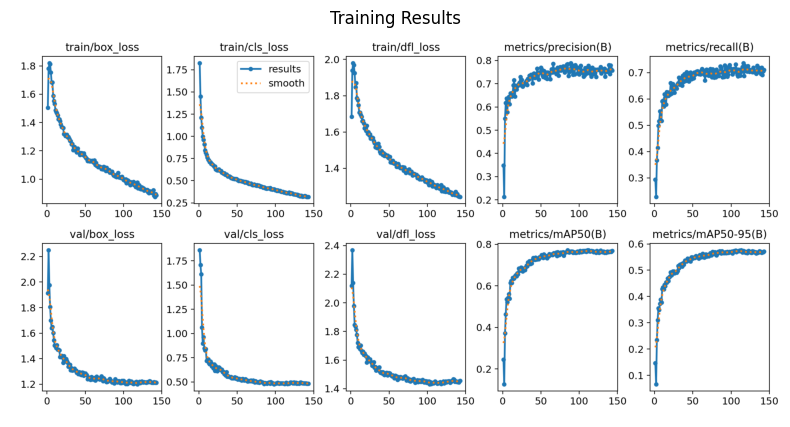

In [ ]:
import matplotlib.pyplot as plt
import cv2

# Load the training results image
results_img_path = "/content/drive/MyDrive/yolo_training/detect/small_objects_aug/results.png"
img = cv2.imread(results_img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for correct visualization

# Display the image
plt.figure(figsize=(10,5))
plt.imshow(img)
plt.axis("off")  # Remove axis labels
plt.title("Training Results")
plt.show()


### Evaluation

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/drive/MyDrive/yolo_training/detect/small_objects_aug/weights/best.pt")  # load a custom model

# Validate the model
metrics = model.val(save_json=True, plots=True, save_txt=True, save_conf=True, save_crop=True)  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps  # a list contains map50-95 of each category

Ultralytics 8.3.109 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/yolo_dataset/labels/val.cache... 563 images, 0 backgrounds, 0 corrupt: 100%|██████████| 563/563 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:14<00:00,  2.51it/s]


                   all        563       1342      0.765      0.704      0.767      0.576
Speed: 0.7ms preprocess, 2.8ms inference, 0.0ms loss, 0.9ms postprocess per image
Saving runs/detect/val/predictions.json...
Results saved to runs/detect/val


array([    0.57611])

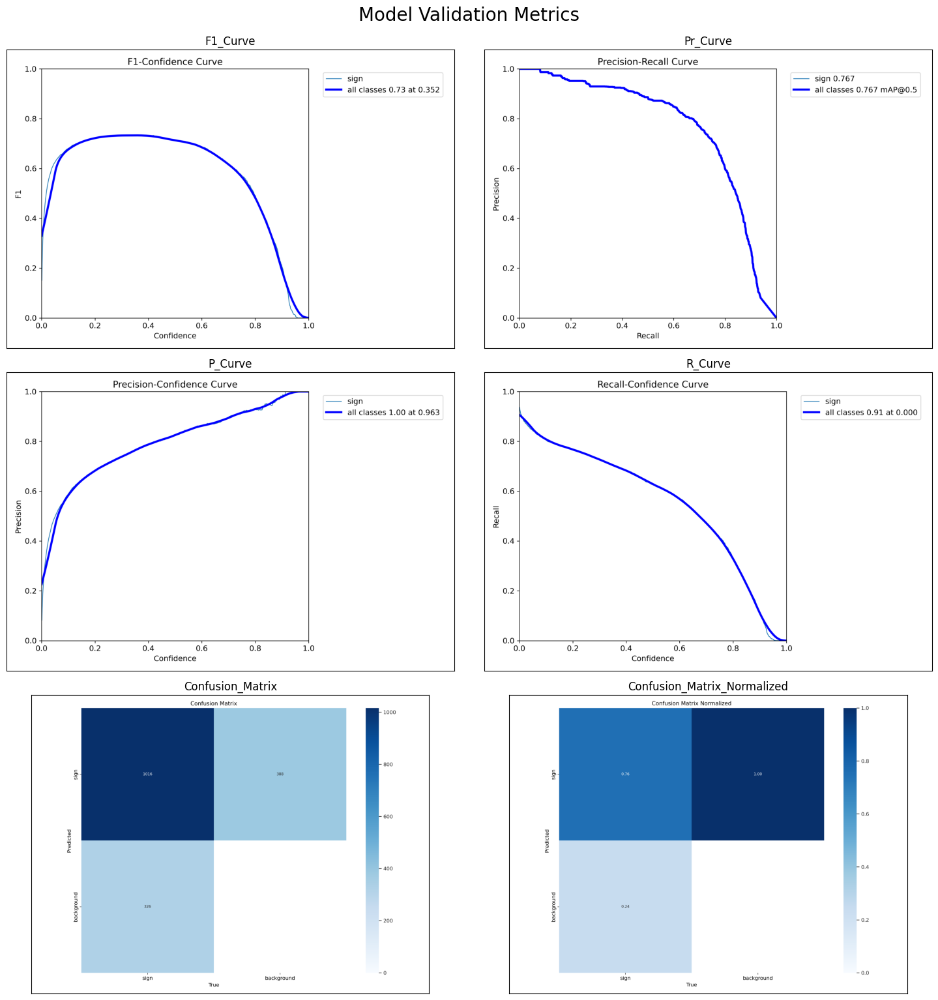

In [ ]:
metrics_dir = '/content/drive/MyDrive/yolo_training/detect/small_objects_aug_val'
display_metrics_images(metrics_dir)

Despite retraining the model with modified hyperparameters and data augmentation techniques targeted at improving small object detection, the evaluation results show minimal improvement in overall performance. The confusion matrix metrics remain largely unchanged, indicating that the model's ability to detect smaller objects has not significantly increased. This suggests that the initial modifications were insufficient to effectively address the challenges posed by small object detection, warranting further investigation and potentially more substantial changes to the training strategy

### FN Analysis

Further analysis will be conducted to confirm that the persistent challenges with small object detection, observed in the re-trained model, stem from the same underlying factors identified in the initial evaluation

In [ ]:
import json

pred_path = "/content/drive/MyDrive/yolo_training/detect/small_objects_aug_val/predictions.json"

with open(pred_path, "r") as f:
    predictions_small_aug = json.load(f)

In [ ]:
# Group predictions by image_id
preds_by_image_retrain = defaultdict(list)
for pred in predictions_small_aug:
    if pred["score"] >= 0.3:
        pred_box = convert_bbox_pred(pred["bbox"])
        preds_by_image_retrain[pred["image_id"]].append({
            "bbox": pred_box,
            "score": pred["score"]
        })

false_negatives_retrain = []

for gt_obj in gt:
    image_id = gt_obj["image_id"]
    gt_box = convert_bbox_gt(gt_obj["bbox"])

    matched = False
    for pred in preds_by_image_retrain.get(image_id, []):
        if iou(gt_box, pred["bbox"]) >= 0.5:
            matched = True
            break

    if not matched:
        fn_data = {
            "image_id": image_id,
            "x_min": gt_box[0],
            "y_min": gt_box[1],
            "x_max": gt_box[2],
            "y_max": gt_box[3],
            "width": gt_box[2] - gt_box[0],
            "height": gt_box[3] - gt_box[1]
        }
        false_negatives_retrain.append(fn_data)

print(f"🔍 Found {len(false_negatives)} false negatives out of {len(gt)} total ground-truth boxes.")


🔍 Found 364 false negatives out of 1342 total ground-truth boxes.


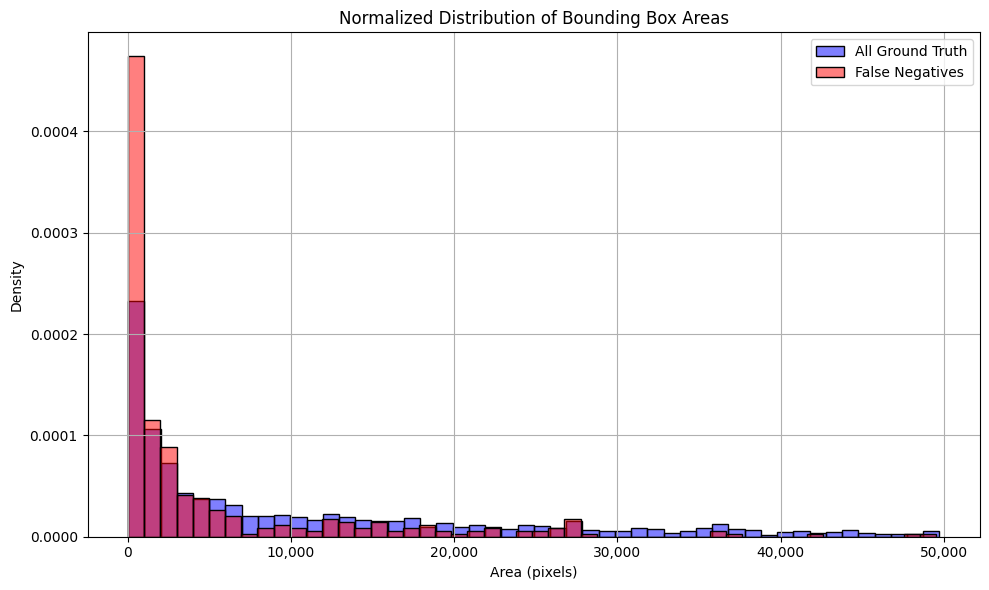

In [ ]:
normal_dist_gt_fn(gt_df, fn_df,50000)

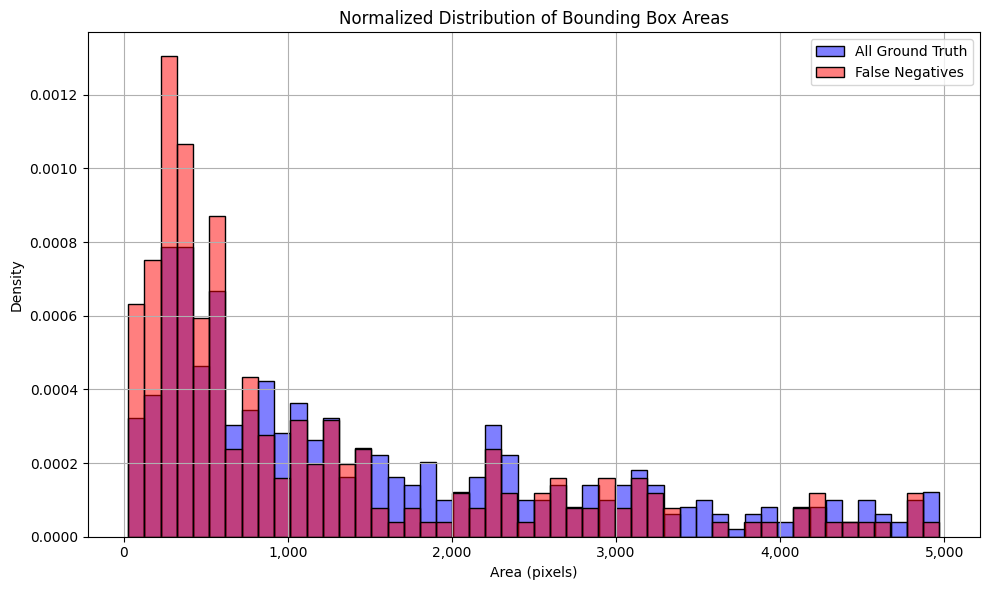

In [ ]:
normal_dist_gt_fn(gt_df, fn_df,5000)

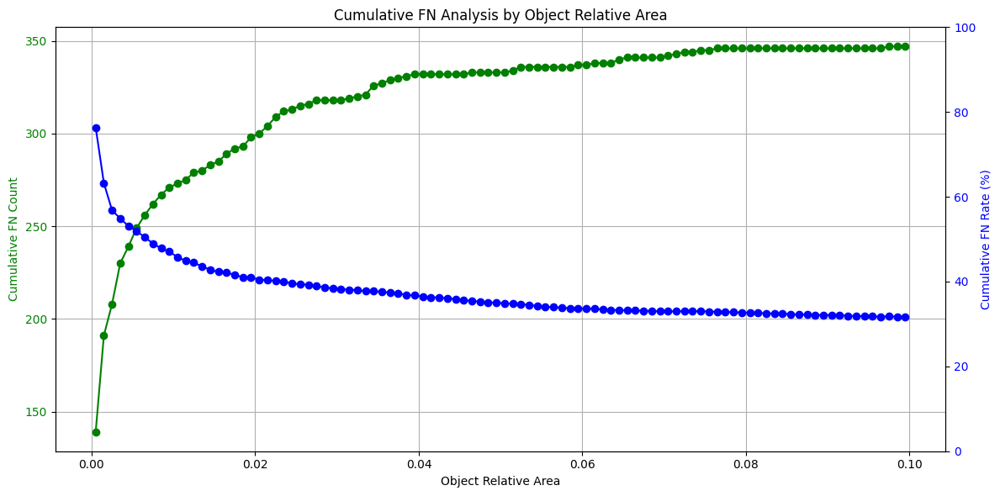

In [ ]:
cumulative_relative_fn_analysis(gt_df, fn_df, 0.1)

The similarity between the size distribution graphs of FN objects and the overall object size distribution, both before and after retraining, suggests that the model's bias towards larger objects persists.

### Conclusion

In conclusion, the graphical analysis reveals that despite retraining efforts with tailored hyperparameters and data augmentation strategies, the model's performance on small object detection remains largely unchanged.

#Project Summary: Traffic Sign Detection using YOLO

This project aimed to develop a traffic sign detection system using the YOLO (You Only Look Once) framework and the Open Images V7 dataset. The primary goal was to achieve accurate and efficient detection of traffic signs in images, contributing to the advancement of intelligent transportation systems and autonomous driving technologies.

##Methodology:

The project followed a structured approach encompassing data collection, validation, exploratory data analysis (EDA), data preparation, model training, and evaluation. The Open Images V7 dataset provided a foundation for training the YOLO model, and rigorous data validation steps ensured the integrity and quality of the dataset. EDA was conducted to gain insights into the characteristics of the dataset, including object size distribution, shapes, and colors. Data preparation involved converting the dataset into the YOLO format and creating necessary configuration files. Model training was performed using the YOLO framework, followed by thorough evaluation using standard metrics.

##Results:

Initial evaluation revealed that the model struggled with detecting small objects, a challenge commonly encountered in object detection tasks. Subsequent retraining efforts with adjusted hyperparameters and data augmentation techniques aimed at addressing this limitation yielded minimal improvements. Further analysis indicated that the persistent challenges with small object detection stemmed from inherent limitations in feature representation or anchor box configuration.

##Potential Improvements:

In hindsight, incorporating strategies specifically designed to handle small objects earlier in the project lifecycle could have potentially improved the overall performance. For example, utilizing data augmentation techniques like upsampling or employing specialized loss functions that emphasize small object detection could have been beneficial. Additionally, exploring alternative model architectures or feature extraction methods known for their effectiveness in small object detection could have yielded better results.

##Future Directions:

Moving forward, future work should focus on addressing the limitations identified in this project. More substantial modifications to the model architecture or feature extraction process could be explored to enhance the detection of smaller traffic signs. Experimenting with custom anchor box configurations tailored to the size distribution of the dataset might further improve detection accuracy. Continued research into state-of-the-art techniques for small object detection is crucial for advancing the performance of traffic sign detection systems.

**Overall, this project provided valuable hands-on experience in developing a traffic sign detection system using the YOLO framework**